# Porovnanie modelovych vystupov 

Script pre porovnanie modelovych vystupov roznych simulacii.
Treba zadat referencnu simulaciu a lubovolny pocet inych simulacii.
Cesty k suborom treba zadat pri jednotlivych pollutantoch.

Grafy:
- Chod rozdielu hodnot simulacie od referencnej na staniciach.
- Mapa rozdielov na celej domene (priemerna) alebo pre konkretne dni (pokial referencna simulacia a porovnavana su v rovnakom gride)

In [1]:
### USER INPUT
# pre kazdy modelovy vstup treba zadat nazov modelu aj grid, aj ked tieto mozu byt pre rozne vstupy rovnake
# poradie nazvov v nasledujucich listoch treba dodrzat, teda prvy prvok v kazdom liste opisuje prvy vstup atd
nick = 'const_emis_cop'   # specificky nazov pre cele porovnanie 
specific = ['cop', 'rh_const']   # specificky nazov pre kazdu z porovnavanych simulacii

ref_model_name = 'CMAQ'
other_model_name = ['CMAQ', 'CMAQ']    # prisluchajuci nazov modelu
ref_grid_name = 'd02'
other_grid_name = ['d02','d02']   # prisluchajuci grid

start_date = '2017-01-01 00:00:00' 
end_date = '2017-12-31 23:59:59'

ref_color = 'r'  # farba referencnej simulacie plotoch
colors = ['black','b','g','limegreen' ]   # farby pre ostatne simulacie v plotoch 

In [2]:
import pandas as pd
import numpy as np
import xarray as xr
from IPython.display import Image, display
import matplotlib.pyplot as plt
import datetime 
import sys
#import netCDF4
vali_path = '/data/teri/validacia'
sys.path.append(vali_path)
import day_of_year as doy
import validacia_v2 as vali
import time

n_start = doy.day_of_year(start_date)
n_end = doy.day_of_year(end_date)
n_days = n_end - n_start + 1

units = 'ug/m3'
statistiky = ['bias','mge','rmse','r']

locs = ['S','R','U']
types = ['B','T','I']
all_types = locs + types

stat = {}
data = {}

color_list = {}
for i in range(0,len(specific)):
    color_list[specific[i]] = colors[i] 

stanice = pd.read_csv('/data/teri/sezonalita_kv_ovzd/stanice_NMSKO_d02.csv')
ID = list(stanice['ii'])[:-5]

stanice

Making connection to database 10.20.7.200
Working on query: 
select * from si.si left join si.si_ext_nmsko as e on e.si_id=si.id where ci=78


,Unnamed: 0,id,ci,ii,name,cccc,cc,iso_cc,lat,lon,...,NO2,NOx,CO,BEN,H2S,O3,coord,x,y,lat_lon
0,0,78001,78,11813,"BRATISLAVA, JESENIOVA",NaN,SK,703,48.167952,17.106209,...,1,1,0,0,0,1,"(21, 92)",21,92,"(48.152134, 17.130432)"
1,1,78002,78,11916,"CHOPOK, EMEP",NaN,SK,703,48.943620,19.589236,...,1,1,0,0,0,1,"(40, 130)",40,130,"(48.928993, 19.58075)"
2,2,78003,78,11952,"GANOVCE, METEO. ST.",NaN,SK,703,49.034601,20.322844,...,1,1,0,0,0,1,"(43, 141)",43,141,"(49.038628, 20.296814)"
3,3,78004,78,11958,KOJSOVSKA HOLA,NaN,SK,703,48.782875,20.987112,...,1,1,0,0,0,1,"(37, 152)",37,152,"(48.76358, 20.986572)"
4,4,78005,78,99111,"BRATISLAVA, MAMATEYOVA",NaN,SK,703,48.124692,17.125400,...,1,1,0,0,1,1,"(20, 92)",20,92,"(48.10979, 17.13034)"
5,5,78006,78,99112,"BRATISLAVA, TRNAVSKE MYTO",NaN,SK,703,48.158359,17.128891,...,1,1,1,1,0,0,"(21, 92)",21,92,"(48.152134, 17.130432)"
6,6,78007,78,99114,"BRATISLAVA, KAMENNE NAM.",NaN,SK,703,48.144670,17.113543,...,0,0,0,0,0,0,"(21, 92)",21,92,"(48.152134, 17.130432)"
7,7,78008,78,99122,"SENICA, HVIEZDOSLAVOVA",NaN,SK,703,48.680681,17.363110,...,0,0,0,0,0,0,"(33, 96)",33,96,"(48.659653, 17.388062)"
8,8,78009,78,99123,"TRNAVA, KOLLAROVA",NaN,SK,703,48.371385,17.584926,...,1,1,1,1,0,0,"(26, 99)",26,99,"(48.36253, 17.577057)"
9,9,78038,78,99126,TRNOVEC NAD VAHOM,NaN,SK,703,48.150000,17.928600,...,0,0,0,0,0,0,"(21, 105)",21,105,"(48.14837, 17.955536)"


In [3]:
def cmaq_to_datetimes(cmaq_dataset):
    start=datetime.datetime.strptime(str(cmaq_dataset.TFLAG.data[0,0,0])+str(cmaq_dataset.TFLAG.data[0,0,1])[:2], '%Y%j%H')
    end=datetime.datetime.strptime(str(cmaq_dataset.TFLAG.data[cmaq_dataset.TFLAG.shape[0]-1,0,0]).zfill(6)+str(cmaq_dataset.TFLAG.data[cmaq_dataset.TFLAG.shape[0]-1,0,1]).zfill(6)[:2], '%Y%j%H')
    times=pd.date_range(start=start, end=end, freq='H')
    cmaq_dataset.coords['TSTEP']=times  

In [4]:
jar = np.full((31+30+31)*24, 'jar')
leto = np.full((30+31+31)*24, 'leto')
jesen = np.full((30+31+30)*24, 'jesen')
zima1 = np.full((31+28)*24, 'zima')
zima2 = np.full(31*24, 'zima')
season = np.concatenate([zima1, jar, leto, jesen, zima2])

season_months = {'jar':[3,4,5], 'leto':[6,7,8], 'jesen':[9,10,11], 'zima':[1,2,12], 'rok':list(range(1,13)),
                'jan':[1], 'feb':[2], 'mar':[3], 'apr':[4], 'maj':[5], 'jun':[6], 'jul':[7], 'aug':[8],
                'sep':[9], 'okt':[10], 'nov':[11], 'dec':[12], 'let_cas':[4,5,6,7,8,9,10], 'zim_cas':[11,12,1,2,3]}

# PM10

In [5]:
v = 'PM10'
ref_path = '/data/oko/dusan/POST/WB_2020_PM_2017'
other_path = ['/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', '/data/oko/dusan/POST/WB_const_PM_2017']

for i in range(0, len(specific)):
    print(specific[i])
    stat[specific[i]], data[specific[i]] = vali.comparison(ref_path, other_path[i], ref_model_name, other_model_name[i], ref_grid_name, other_grid_name[i], start_date, end_date, v)
    

cop
Comparison of PM10 done in 45.21451163291931 seconds
rh_const
Comparison of PM10 done in 8.277465343475342 seconds


In [6]:
#data['rh_const'].sel(time = data['rh_const'].time.dt.month.isin([3,4,5]))
v

'PM10'

## Statistika (R, RMSE, BIAS, MGE) s referencnym runom

In [6]:
stat_all = stat[specific[0]][['name','loc','type']].copy()
stat_all.head()

for s in statistiky:
    for i in specific:
        stat_all['{0}_{1}'.format(s,i)] = stat[i][s]

#stat_all.head()
stat_all

,name,loc,type,bias_cop,bias_rh_const,mge_cop,mge_rh_const,rmse_cop,rmse_rh_const,r_cop,r_rh_const
all,all,all,all,0.148225,0.0591911,0.193392,0.527842,0.375313,0.939504,0.998479,0.986257
11813,"BRATISLAVA, JESENIOVA",S,B,0.201374,0.114474,0.316462,0.835186,0.531833,1.28477,0.997817,0.98313
11916,"CHOPOK, EMEP",R,B,0.0414217,0.0571065,0.0472704,0.126478,0.0756262,0.1812,0.999704,0.997773
11952,"GANOVCE, METEO. ST.",R,B,0.119199,0.0536851,0.157913,0.525113,0.234353,0.776889,0.998385,0.973452
11958,KOJSOVSKA HOLA,R,B,0.082347,0.0342323,0.0990609,0.282767,0.161164,0.412436,0.999398,0.993997
99111,"BRATISLAVA, MAMATEYOVA",U,B,0.145535,0.102689,0.196836,0.506881,0.375083,0.883707,0.998789,0.99122
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,0.201374,0.114474,0.316462,0.835186,0.531833,1.28477,0.997817,0.98313
99114,"BRATISLAVA, KAMENNE NAM.",U,B,0.201374,0.114474,0.316462,0.835186,0.531833,1.28477,0.997817,0.98313
99117,BRATISLAVA - RACA,None,None,0.125519,0.0692676,0.181097,0.479258,0.334762,0.77899,0.998941,0.992346
99122,"SENICA, HVIEZDOSLAVOVA",U,T,0.0862706,0.0654656,0.112334,0.321472,0.222966,0.565534,0.999503,0.995674


## Priprava emisii 

In [19]:
#emisie_list = ['ref','tot_const','rh_const']
#emisie_file = {'ref':'WB_2017_d02', 'rh_const':'WB_2017_const', 'tot_const':'WB_2017_totcons'}
emisie_list = ['ref','tot_const', 'rh_const']
emisie_file = {'ref':'WB_2017_d02', 'rh_const':'WB_2017_const', 'tot_const':'WB_2017_totcons'}

emisie_pm10 = {}

for e in emisie_list:
    print(e)
    start_time = time.time()
    emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],start_date[:10]))
    emisie_full['PM10']=emisie_full['PEC']+emisie_full['POC']+emisie_full['PSO4']+emisie_full['PMC']+emisie_full['PMFINE']
    emisie_pm10[e] = emisie_full['PM10'][:(-1),:,:,:].sum(axis=1)
    
    for i in range(n_start+1,n_days + 1):
        date = doy.date_from_day(i, start_date[0:4])
        #print(date)
        #ref_model_new = xr.open_dataset('{0}{1}.nc'.format(ref_path,date))[var_mod[ref_name][v]]
        emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],date))
        emisie_full['PM10']=emisie_full['PEC']+emisie_full['POC']+emisie_full['PSO4']+emisie_full['PMC']+emisie_full['PMFINE']
        emisie_new = emisie_full['PM10'][:(-1),:,:,:].sum(axis=1)
        emisie_pm10[e] = xr.concat([emisie_pm10[e], emisie_new], 'TSTEP')

    print('{0}-{1} done in {2} s'.format(start_date,date,time.time()-start_time))

ref


KeyboardInterrupt: 

In [ ]:
times=pd.date_range(start=start_date, end=end_date, freq='H')
for e in emisie_list:
    emisie_pm10[e].coords['TSTEP']=times
    emisie_pm10[e].coords['ROW'] = np.linspace(0,102,103)
    emisie_pm10[e].coords['COL'] = np.linspace(0,183,184)
    
emisie_pm10

In [ ]:
emis_stanice_pm10 = {}
ID = list(stanice['ii'])[:-5]

for e in emisie_list:
    emis_stanice_pm10[e] = pd.DataFrame()
    emis_stanice_pm10[e]['season'] = pd.Series(season)
    for i in ID:
        x = stanice['x'].loc[stanice.ii == i].item()
        y = stanice['y'].loc[stanice.ii == i].item()
        emis_stanice_pm10[e][i] = pd.Series(emisie_pm10[e][:,x,y])

    new_index = pd.date_range(start_date, end_date , freq='H')
    emis_stanice_pm10[e] = emis_stanice_pm10[e].set_index(new_index)

emis_stanice_pm10[e][11813].loc[emis_stanice_pm10[e]['season']=='jar']

In [16]:
#ID

## Priprava emisii new

In [31]:
#emisie_full

In [7]:
#emisie_list = ['ref','tot_const','rh_const']
#emisie_file = {'ref':'WB_2017_d02', 'rh_const':'WB_2017_const', 'tot_const':'WB_2017_totcons'}
emisie_list = ['ref','cop', 'rh_const']
emisie_file = {'ref':'WB_2017_d02', 'rh_const':'WB_2017_const', 'cop':'WB_2017_CAMS_13_res_heat'}
emisie_pm10 = {}

for e in emisie_list:
    print(e)
    start_time = time.time()
    emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],start_date[:10]))
    emisie_full['PM10']=emisie_full['PEC']+emisie_full['POC']+emisie_full['PSO4']+emisie_full['PMC']+emisie_full['PMFINE']
    emisie_pm10[e] = emisie_full['PM10'][:(-1),:,:,:].sum(axis=1)
    
    for i in range(n_start+1,n_days + 1):
        date = doy.date_from_day(i, start_date[0:4])
        #print(date)
        #ref_model_new = xr.open_dataset('{0}{1}.nc'.format(ref_path,date))[var_mod[ref_name][v]]
        emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],date))
        emisie_full['PM10']=emisie_full['PEC']+emisie_full['POC']+emisie_full['PSO4']+emisie_full['PMC']+emisie_full['PMFINE']
        emisie_new = emisie_full['PM10'][:(-1),:,:,:].sum(axis=1)
        emisie_pm10[e] = xr.concat([emisie_pm10[e], emisie_new], 'TSTEP')

    print('{0}-{1} done in {2} s'.format(start_date,date,time.time()-start_time))

ref
2017-01-01 00:00:00-2017-12-31 done in 572.4749844074249 s
cop
2017-01-01 00:00:00-2017-12-31 done in 669.7398924827576 s
rh_const
2017-01-01 00:00:00-2017-12-31 done in 715.2774686813354 s


In [85]:
emisie_pm10['cop']

<xarray.DataArray 'PM10' (TSTEP: 8760, ROW: 103, COL: 184)>
array([[[0.06051393, 0.06705536, 0.01682146, ..., 0.24819729,
         0.25934654, 0.3056224 ],
        [0.05460269, 0.06275688, 0.01970082, ..., 0.2599488 ,
         0.2366592 , 0.19362791],
        [0.07735021, 0.07518189, 0.02774988, ..., 0.23926497,
         0.31743762, 0.40687096],
        ...,
        [1.3778449 , 0.25089565, 0.24332349, ..., 0.16271728,
         0.14645758, 0.06028961],
        [0.08236148, 0.06658391, 0.05225041, ..., 0.10810536,
         0.10630116, 0.07473485],
        [0.03025458, 0.02720558, 0.02420717, ..., 0.06741562,
         0.07321257, 0.07669342]],

       [[0.0578956 , 0.06398095, 0.01613808, ..., 0.24799527,
         0.25914252, 0.305394  ],
        [0.05196493, 0.05943675, 0.01872311, ..., 0.25972077,
         0.23645747, 0.19347575],
        [0.07380395, 0.0708849 , 0.02625446, ..., 0.23908593,
         0.31721073, 0.40659127],
...
        [1.2260023 , 0.2357714 , 0.23988521, ..., 0.17882638,
         0.1618463 , 0.06596956],
        [0.08182774, 0.0694064 , 0.06260718, ..., 0.11967161,
         0.11757851, 0.08229342],
        [0.03249072, 0.02977335, 0.02961162, ..., 0.07468376,
         0.08104292, 0.08471845]],

       [[0.08945559, 0.09913107, 0.0242951 , ..., 0.33911088,
         0.35468364, 0.41825366],
        [0.0817438 , 0.09408374, 0.02936152, ..., 0.35126245,
         0.31896895, 0.2586419 ],
        [0.11724193, 0.11555614, 0.04228222, ..., 0.30168587,
         0.41220373, 0.5388452 ],
        ...,
        [1.6002104 , 0.29452512, 0.28718027, ..., 0.21003038,
         0.18927523, 0.07505099],
        [0.09437383, 0.07612814, 0.06087855, ..., 0.13973463,
         0.13721573, 0.09526486],
        [0.03378304, 0.0305527 , 0.02816137, ..., 0.08704602,
         0.09450335, 0.09891834]]], dtype=float32)
Dimensions without coordinates: TSTEP, ROW, COL

In [9]:
times=pd.date_range(start=start_date, end=end_date, freq='H')
for e in emisie_list:
    emisie_pm10[e].coords['TSTEP']=times
    emisie_pm10[e].coords['ROW'] = np.linspace(0,102,103)
    emisie_pm10[e].coords['COL'] = np.linspace(0,183,184)
    
emisie_pm10

{'ref': <xarray.DataArray 'PM10' (TSTEP: 8760, ROW: 103, COL: 184)>
 array([[[0.06051393, 0.06705536, 0.01682146, ..., 0.24819729,
          0.25934654, 0.3056224 ],
         [0.05460269, 0.06275688, 0.01970082, ..., 0.2599488 ,
          0.2366592 , 0.19362791],
         [0.07735021, 0.07518189, 0.02774988, ..., 0.23926497,
          0.31743762, 0.40687096],
         ...,
         [1.3778449 , 0.25089565, 0.24332349, ..., 0.16271728,
          0.14645758, 0.06028961],
         [0.08236148, 0.06658391, 0.05225041, ..., 0.10810536,
          0.10630116, 0.07473485],
         [0.03025458, 0.02720558, 0.02420717, ..., 0.06741562,
          0.07321257, 0.07669342]],
 
        [[0.0578956 , 0.06398095, 0.01613808, ..., 0.24799527,
          0.25914252, 0.305394  ],
         [0.05196493, 0.05943675, 0.01872311, ..., 0.25972077,
          0.23645747, 0.19347575],
         [0.07380395, 0.0708849 , 0.02625446, ..., 0.23908593,
          0.31721073, 0.40659127],
 ...
         [1.4143004 , 0.2638

In [35]:
emis_stanice_pm10 = {}

for e in emisie_list:
    emis_stanice_pm10[e] = pd.DataFrame()
    emis_stanice_pm10[e]['season'] = pd.Series(season)
    for i in ID:
        x = stanice['x'].loc[stanice.ii == i].item()
        y = stanice['y'].loc[stanice.ii == i].item()
        emis_stanice_pm10[e][i] = pd.Series(emisie_pm10[e][:,x,y])

    new_index = pd.date_range(start_date, end_date , freq='H')
    emis_stanice_pm10[e] = emis_stanice_pm10[e].set_index(new_index)
    
#new_mean = emis_stanice_pm10['ref'][ID_B].loc[season =='leto'].groupby(emis_stanice_pm10['ref'][ID_B].loc[emis_stanice_pm10['ref']['season']=='leto'].index.hour).mean()

#new_mean['daily_avrg'] = new_mean.mean(axis = 1)
#new_mean['daily_avrg']

## Variacny koeficient

In [39]:
(emis_stanice[e].loc[emis_stanice[e]['season']==my_season]).stack()

2017-03-01 00:00:00  season           jar
                     11813        1.00298
                     11916     0.00235345
                     11952       0.283315
                     11958      0.0924498
                                  ...    
2017-05-31 23:00:00  99801      0.0459696
                     99802      0.0459696
                     99807      0.0459696
                     99808      0.0459696
                     99811      0.0459696
Length: 125856, dtype: object

In [47]:
#start_day = '2017-01-01 00:00:00'
#end_day = '2017-02-28 23:59:59'
my_season = 'jesen'

stat_var_coef = stat[specific[0]][['name','loc','type']].copy()
stat_var_coef['ref'] = stat[specific[0]]['ref_var_coef'].copy()
for i in specific:
    stat_var_coef[i] = stat[i]['other_var_coef'].copy()
    
for e in emisie_list:
    stat_var_coef['emis_{0}'.format(e)] = pd.Series(dtype = 'float64')
    for i in ID:
        std_emis = np.std(np.array(emis_stanice[e][i].loc[emis_stanice[e]['season']==my_season]))
        mean_emis = np.mean(np.array(emis_stanice[e][i].loc[emis_stanice[e]['season']==my_season]))
        stat_var_coef.at[i, 'emis_{0}'.format(e)] = std_emis/mean_emis
        
    emis_stacked = (emis_stanice[e].loc[emis_stanice[e]['season']==my_season]).drop(['season'], axis=1).stack()
    std_emis = np.std(emis_stacked)
    mean_emis = np.mean(emis_stacked)
    stat_var_coef.at['all', 'emis_{0}'.format(e)] = std_emis/mean_emis

print('Koeficient variacie, {0}'.format(my_season))
stat_var_coef
#emis_stanice_all

Koeficient variacie, jesen


,name,loc,type,ref,rh_const,tot_const,emis_ref,emis_tot_const,emis_rh_const
all,all,all,all,0.87632,0.817948,0.783647,1.354016,1.354016,1.354016
11813,"BRATISLAVA, JESENIOVA",S,B,0.835837,0.756197,0.731074,0.603623,0.603623,0.603623
11916,"CHOPOK, EMEP",R,B,0.71651,0.712866,0.68026,0.642987,0.642987,0.642987
11952,"GANOVCE, METEO. ST.",R,B,0.680182,0.636659,0.606498,0.523747,0.523747,0.523747
11958,KOJSOVSKA HOLA,R,B,0.754545,0.734838,0.684891,0.732304,0.732304,0.732304
99111,"BRATISLAVA, MAMATEYOVA",U,B,0.811204,0.762197,0.729723,0.267963,0.267963,0.267963
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,0.835837,0.756197,0.731074,0.603623,0.603623,0.603623
99114,"BRATISLAVA, KAMENNE NAM.",U,B,0.835837,0.756197,0.731074,0.603623,0.603623,0.603623
99122,"SENICA, HVIEZDOSLAVOVA",U,T,0.854658,0.819037,0.785657,0.470382,0.470382,0.470382
99123,"TRNAVA, KOLLAROVA",U,T,0.88705,0.829567,0.790392,0.575931,0.575931,0.575931


In [11]:
#emis_stanice_all_copy[start_day:end_day]
#podiel_mean

## Korelacie

### Korelacia full/const vs emis

Korelacia full/const_rh a full/tot_const s emisnym profilom

In [54]:
#emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].drop(['season'], axis=1).stack()['2017-03-01 00:00:00']
#podiel_all['2017-03-01 00:00:00']
#podiel_al

podiel_all.index.names = (None, None)
#podiel_all.columns.names = (None,None)
podiel_all_mean
#emis_stanice_pm10_all_mean.stack()

0   11813    0.863114
    11916    1.045523
    11952    0.942064
    11958    1.026075
    99111    0.903458
               ...   
23  99801    0.988175
    99802    0.988175
    99807    0.988175
    99808    0.988175
    99811    0.988175
Length: 1344, dtype: float32

In [55]:
stat_corrs = stat[specific[0]][['name','loc','type']].copy()
for s in specific:
    stat_corrs['full/{0}_VS_emis'.format(s)] = pd.Series(dtype = 'float32')
    stat_corrs['full/{0}_VS_emis_mean'.format(s)] = pd.Series(dtype = 'float32')

podiel = {}

my_season = 'jar'
#start_day = '2017-01-01 00:00:00'
#end_day = '2017-02-28 23:59:59'

for i in specific:
    podiel_all = (data[i]['Reference']/data[i]['Other']).sel(time = data[i].time.dt.month.isin(season_months[my_season]), station = ID).to_series()
    #podiel_all = podiel_all.stack()
    podiel_all.index.names = (None, None)
    stat_corrs.at['all', 'full/{0}_VS_emis'.format(i)] = podiel_all.corr(emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].drop(['season'], axis=1).stack())
    
    ref_all_mean = data[i]['Reference'].sel(time = data[i].time.dt.month.isin(season_months[my_season]), station = ID).groupby('time.hour').mean()
    other_all_mean = data[i]['Other'].sel(time = data[i].time.dt.month.isin(season_months[my_season]), station = ID).groupby('time.hour').mean()
    emis_stanice_pm10_all_mean = emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].drop(['season'], axis=1).groupby(emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].index.hour).mean()
    podiel_all_mean = (ref_all_mean/other_all_mean).to_series()
    podiel_all_mean.index.names = (None, None)
    stat_corrs.at['all', 'full/{0}_VS_emis_mean'.format(i)] = podiel_all_mean.corr(emis_stanice_pm10_all_mean.stack())
                      
    for s in ID:
        #print(s)
        podiel = (data[i]['Reference'].sel(station = s)/data[i]['Other'].sel(station = s)).sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        #podiel = podiel.to_series().copy()
        #emis_id = np.array(emis_stanice_pm10_all[s])
        #stat_corrs['{0}_VS_full'.format(i)][s] = podiel.corr(emis_stanice_pm10_all[s].copy())
        stat_corrs.at[s, 'full/{0}_VS_emis'.format(i)] = podiel.corr(emis_stanice_pm10['ref'][s].loc[emis_stanice_pm10['ref']['season']==my_season])
        
        ref_mean = data[i]['Reference'].sel(station = s,time = data[i].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        other_mean = data[i]['Other'].sel(station = s,time = data[i].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        emis_stanice_pm10_mean = emis_stanice_pm10['ref'][s].loc[emis_stanice_pm10['ref']['season']==my_season].groupby(emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].index.hour).mean()
        podiel_mean = ref_mean/other_mean   
        stat_corrs.at[s, 'full/{0}_VS_emis_mean'.format(i)] = podiel_mean.to_series().corr(emis_stanice_pm10_mean)
    

#podiel_all
#emis_stanice_pm10_all_copy
stat_corrs

,name,loc,type,full/tot_const_VS_emis,full/tot_const_VS_emis_mean
all,all,all,all,0.223389,0.086812
11813,"BRATISLAVA, JESENIOVA",S,B,0.725629,0.792202
11916,"CHOPOK, EMEP",R,B,0.479732,0.228141
11952,"GANOVCE, METEO. ST.",R,B,0.637373,0.805649
11958,KOJSOVSKA HOLA,R,B,0.574842,0.363125
99111,"BRATISLAVA, MAMATEYOVA",U,B,0.625370,0.751603
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,0.725629,0.792202
99114,"BRATISLAVA, KAMENNE NAM.",U,B,0.725629,0.792202
99122,"SENICA, HVIEZDOSLAVOVA",U,T,0.646093,0.496256
99123,"TRNAVA, KOLLAROVA",U,T,0.672158,0.637050


In [66]:
#list(stanice.loc[stanice.type == 'T']['ii'])
#emis_stanice_all_copy
podiel_mean

time                 station
2017-01-01 00:00:00  11813      0.985468
                     99126      1.050754
                     99130      1.108147
                     99242      1.081312
                     99315      1.031261
                                  ...   
2017-02-28 23:00:00  99315      0.997454
                     99501      0.972970
                     99503      0.883489
                     99701      1.000061
                     99703      0.997716
Length: 12744, dtype: float32

### Korelacie podla typov stanic

In [77]:
locs = ['S','R','U']
types = ['B','T','I']
all_types = locs + types

#start_day = '2017-01-01 00:00:00'
#end_day = '2017-02-28 23:59:59'
my_season = 'jar'

stat_corrs_type_columns = ['full/rh_const_VS_emis', 'full/rh_const_VS_emis_mean','full/tot_const_VS_emis', 'full/tot_const_VS_emis_mean']
stat_corrs_type = pd.DataFrame(index = all_types, columns = stat_corrs_type_columns)

podiel = {}
for i in specific:
    for t in all_types:
        if t in locs:
            col = 'loc'
        else:
            col = 'type'
        
        stanice_vyber = list(stanice[:-5].loc[stanice[col] == t]['ii'])
        emis_vyber = emis_stanice_pm10['ref'][stanice_vyber].loc[emis_stanice_pm10['ref']['season']==my_season].stack()
        podiel = (data[i]['Reference'].sel(station = stanice_vyber)/data[i]['Other'].sel(station = stanice_vyber)).sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        podiel.index.names = (None, None)
        stat_corrs_type.at[t, 'full/{0}_VS_emis'.format(i)] = podiel.corr(emis_vyber) 
        
        emis_vyber_mean = emis_stanice_pm10['ref'][stanice_vyber].loc[emis_stanice_pm10['ref']['season']==my_season].groupby(emis_stanice_pm10['ref'][stanice_vyber].loc[emis_stanice_pm10['ref']['season']==my_season].index.hour).mean().stack()
        ref_mean = data[i]['Reference'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        other_mean = data[i]['Other'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        podiel_mean = (ref_mean/other_mean).to_series()
        stat_corrs_type.at[t, 'full/{0}_VS_emis_mean'.format(i)] = podiel_mean.corr(emis_vyber_mean)
        
stat_corrs_type

,full/rh_const_VS_emis,full/rh_const_VS_emis_mean,full/tot_const_VS_emis,full/tot_const_VS_emis_mean
S,NaN,NaN,0.30699,0.235792
R,NaN,NaN,0.248672,0.134468
U,NaN,NaN,0.245908,0.0996078
B,NaN,NaN,0.279766,0.17566
T,NaN,NaN,0.155051,-0.0351867
I,NaN,NaN,0.363476,0.249678


In [72]:
list(stanice['ii'][:-5].loc[stanice[:-5][col] == t])

[11813, 99126, 99130, 99242, 99315, 99501, 99503, 99701, 99703]

In [73]:
stat_corrs_type_columns = ['full/rh_const_VS_emis', 'full/rh_const_VS_emis_mean','full/tot_const_VS_emis', 'full/tot_const_VS_emis_mean']
stat_corrs_type = pd.DataFrame(index = all_types, columns = stat_corrs_type_columns)

podiel = {}

my_season = 'jar'
#start_day = '2017-01-01 00:00:00'
#end_day = '2017-02-28 23:59:59'

for i in specific:
    """
    podiel_all = (data[i]['Reference']/data[i]['Other']).sel(time = data[i].time.dt.month.isin(season_months[my_season]), station = ID).to_series()
    #podiel_all = podiel_all.stack()
    podiel_all.index.names = (None, None)
    stat_corrs.at['all', 'full/{0}_VS_emis'.format(i)] = podiel_all.corr(emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].drop(['season'], axis=1).stack())
    
    ref_all_mean = data[i]['Reference'].sel(time = data[i].time.dt.month.isin(season_months[my_season]), station = ID).groupby('time.hour').mean()
    other_all_mean = data[i]['Other'].sel(time = data[i].time.dt.month.isin(season_months[my_season]), station = ID).groupby('time.hour').mean()
    emis_stanice_pm10_all_mean = emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].drop(['season'], axis=1).groupby(emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].index.hour).mean()
    podiel_all_mean = (ref_all_mean/other_all_mean).to_series()
    podiel_all_mean.index.names = (None, None)
    stat_corrs.at['all', 'full/{0}_VS_emis_mean'.format(i)] = podiel_all_mean.corr(emis_stanice_pm10_all_mean.stack())
    """                  
    for t in all_types:
        if t in locs:
            col = 'loc'
        else:
            col = 'type'
        
        stanice_vyber = list(stanice['ii'][:-5].loc[stanice[:-5][col] == t])
        podiel = (data[i]['Reference'].sel(station = stanice_vyber)/data[i]['Other'].sel(station = stanice_vyber)).sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        #podiel = podiel.to_series().copy()
        #emis_id = np.array(emis_stanice_pm10_all[s])
        #stat_corrs['{0}_VS_full'.format(i)][s] = podiel.corr(emis_stanice_pm10_all[s].copy())
        stat_corrs.at[t, 'full/{0}_VS_emis'.format(i)] = podiel.corr(emis_stanice_pm10['ref'][stanice_vyber].loc[emis_stanice_pm10['ref']['season']==my_season])
        
        ref_mean = data[i]['Reference'].sel(station = stanice_vyber,time = data[i].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        other_mean = data[i]['Other'].sel(station = stanice_vyber,time = data[i].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        emis_stanice_pm10_mean = emis_stanice_pm10['ref'][stanice_vyber].loc[emis_stanice_pm10['ref']['season']==my_season].groupby(emis_stanice_pm10['ref'].loc[emis_stanice_pm10['ref']['season']==my_season].index.hour).mean()
        podiel_mean = ref_mean/other_mean   
        stat_corrs.at[t, 'full/{0}_VS_emis_mean'.format(i)] = podiel_mean.to_series().corr(emis_stanice_pm10_mean)
    

#podiel_all
#emis_stanice_pm10_all_copy
stat_corrs

ValueError: cannot join with no overlapping index names

In [68]:
stat_corrs_type


,full/rh_const_VS_emis,full/tot_const_VS_emis,full/rh_const_VS_emis_mean,full/tot_const_VS_emis_mean
S,0.398157,0.246931,0.575825,0.392821
R,0.308862,0.244327,0.511126,0.456664
U,0.361032,0.273812,0.488130,0.455488
B,0.401379,0.293507,0.570125,0.503623
T,0.214951,0.170897,0.277540,0.301375
I,0.570872,0.387097,0.739582,0.592622


### Korelacie concentracii s emisnym profilom

## Hodinovy chod relativnych rozdielov na staniciach

Relativny rozdiel tu znamena: (full_model - const_model)/full_model

teda relativne k hodnote full modelu v danej hodine

In [6]:
### USER INPUT
# Choose stations to plot
#ID = list(stat_all.index.values)[1:]   # all stations
ID = [11813,11916]    # selected stations
save = False   # save the plots?

# Plotted period (plot from day n to day m of the selected period, where n,m are integers)
plot_from = 1
plot_until = 7   # default: n_days  -  whole selected period

save_path = '{0}/compared/{1}_{2}/graphs/relat_diff_{3}'.format(vali_path, nick, start_date[0:4],v)


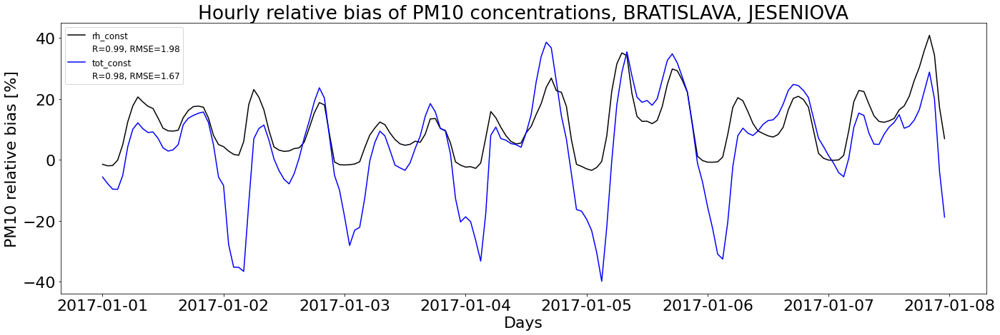

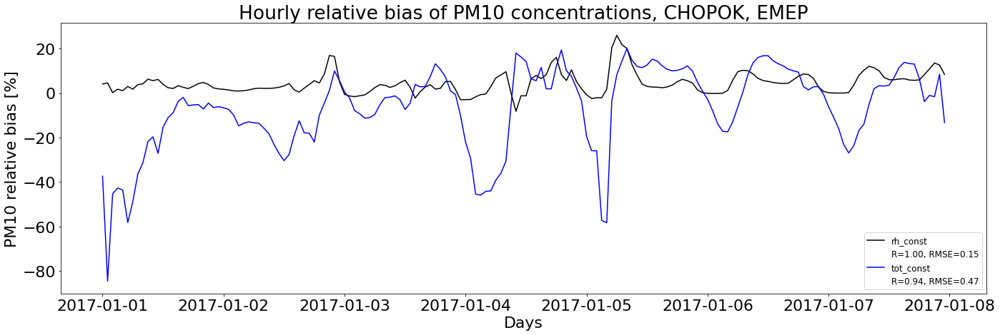

In [10]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    ref_id = data[specific[0]]['Reference'].sel(station = i).to_series()[(plot_from-1)*24:plot_until*24]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    #plt.plot(ref_id.index[:], ref_id[:], color = ref_color, label = 'Reference run')                
    for s in specific:
        mod_id = data[s]['Other'].sel(station = i).to_series()[(plot_from-1)*24:plot_until*24]
        diff_id = 100*(ref_id - mod_id)/ref_id
        
        stat_corr = mod_id.corr(ref_id)
        stat_diff = np.array((mod_id - ref_id))
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        #plt.plot(obs_id.index[(plot_from-1)*24:plot_until*24], mod_id[(plot_from-1)*24:plot_until*24], color = color_list[s], label = '{}'.format(s))
        plt.plot(ref_id.index[:], diff_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Hourly relative bias of {0} concentrations, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} relative bias [%]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()
    

## Hodinovy chod normovanych rozdielov na staniciach

Normovany rozdiel tu znamena: (full_model - const_model)/full_model.mean()

teda nanormovany k priemernej hodnote full model pocas celeho obdobia

In [11]:
### USER INPUT
# Choose stations to plot
#ID = list(stat_all.index.values)[1:]   # all stations
ID = [11813,11916]    # selected stations
save = False   # save the plots?

# Plotted period (plot from day n to day m of the selected period, where n,m are integers)
plot_from = 1
plot_until = 7   # default: n_days  -  whole selected period

save_path = '{0}/compared/{1}_{2}/graphs/norm_diff_{3}'.format(vali_path, nick, start_date[0:4],v)

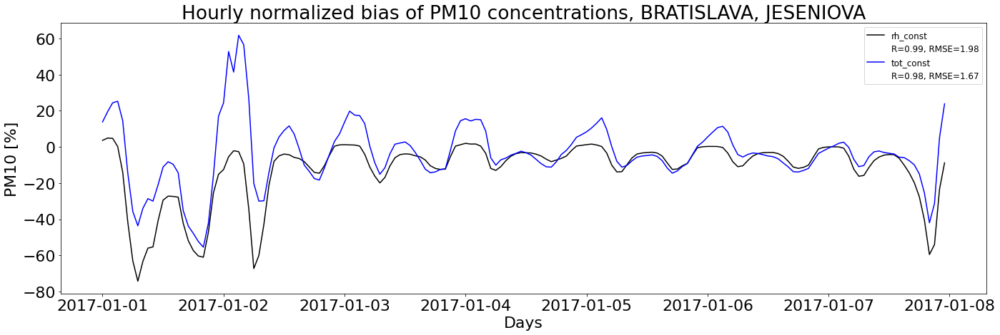

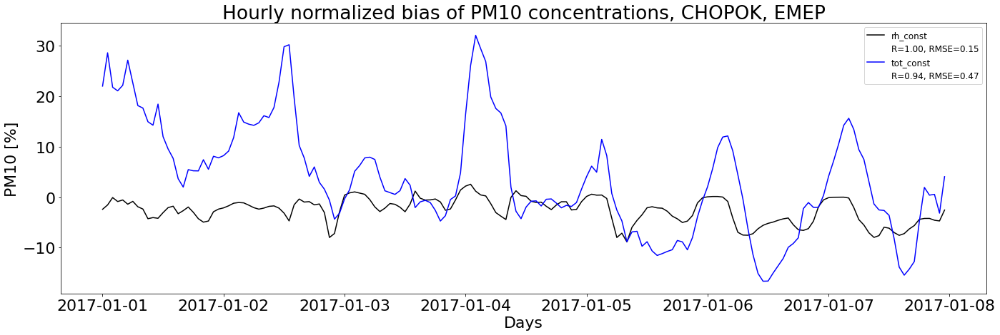

In [12]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    ref_id = data[specific[0]]['Reference'].sel(station = i).to_series()[(plot_from-1)*24:plot_until*24]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    #plt.plot(ref_id.index[:], ref_id[:], color = ref_color, label = 'Reference run')                
    for s in specific:
        mod_id = data[s]['Other'].sel(station = i).to_series()[(plot_from-1)*24:plot_until*24]
        diff_id = 100*(mod_id - ref_id)/data[specific[0]]['Reference'].sel(station = i).to_series().mean()
        
        stat_corr = mod_id.corr(ref_id)
        stat_diff = np.array((mod_id - ref_id))
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        #plt.plot(obs_id.index[(plot_from-1)*24:plot_until*24], mod_id[(plot_from-1)*24:plot_until*24], color = color_list[s], label = '{}'.format(s))
        plt.plot(ref_id.index[:], diff_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Hourly normalized bias of {0} concentrations, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [%]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()
    

## Emisie rocne obodbia

In [50]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
spec_nick = 'ref'

save = False   # save the plots?  


save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

In [51]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    emis_id_jar = emisie[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie[spec_nick].TSTEP.dt.month.isin(season_months['jar'])).groupby('TSTEP.hour').mean()
    emis_id_leto = emisie[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie[spec_nick].TSTEP.dt.month.isin(season_months['leto'])).groupby('TSTEP.hour').mean()
    emis_id_jesen = emisie[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie[spec_nick].TSTEP.dt.month.isin(season_months['jesen'])).groupby('TSTEP.hour').mean()
    emis_id_zima = emisie[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie[spec_nick].TSTEP.dt.month.isin(season_months['zima'])).groupby('TSTEP.hour').mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(emis_id_jar.hour, emis_id_jar[:,0,0], color ='green', label = 'jar') 
    plt.plot(emis_id_leto.hour, emis_id_leto[:,0,0], color ='red', label = 'leto')
    plt.plot(emis_id_jesen.hour, emis_id_jesen[:,0,0], color ='orange', label = 'jesen') 
    plt.plot(emis_id_zima.hour, emis_id_zima[:,0,0], color ='blue', label = 'zima')

    plt.legend(fontsize=12)                
    plt.title('Mean hourly emissions of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

TypeError: '.dt' accessor only available for DataArray with datetime64 timedelta64 dtype or for arrays containing cftime datetime objects.

## Emisie rocne obdobia staton types

Plots will be saved at:/data/teri/validacia/validated/const_emis_2017/graphs/NO2


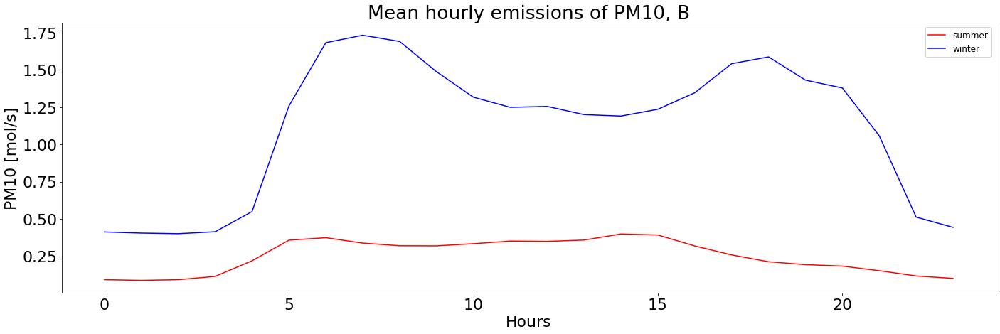

In [39]:
save = True
if save:
    print('Plots will be saved at:{}'.format(save_path))
    
emis_id_leto = emisie_pm10[spec_nick].sel(ROW = 10, COL = 10, TSTEP = emisie_pm10[spec_nick].TSTEP.dt.month.isin(season_months['leto'])).groupby('TSTEP.hour').mean()

#emis_leto_mean = emis_stanice_pm10[spec_nick][ID_B].loc[emis_stanice_pm10[spec_nick]['season']=='leto'].groupby(emis_stanice_pm10[spec_nick][ID_B].loc[emis_stanice_pm10[spec_nick]['season']=='leto'].index.hour).mean().stack()        
#emis_zima_mean = emis_stanice_pm10[spec_nick][ID_B].loc[emis_stanice_pm10[spec_nick]['season']=='zima'].groupby(emis_stanice_pm10[spec_nick][ID_B].loc[emis_stanice_pm10[spec_nick]['season']=='zima'].index.hour).mean().stack()        

emis_jar_mean = emis_stanice_pm10[spec_nick][ID_B].loc[season =='jar'].groupby(emis_stanice_pm10[spec_nick][ID_B].loc[emis_stanice_pm10[spec_nick]['season']=='jar'].index.hour).mean()
emis_jar_mean['daily_avrg'] = emis_jar_mean.mean(axis = 1)

emis_leto_mean = emis_stanice_pm10[spec_nick][ID_B].loc[season =='leto'].groupby(emis_stanice_pm10[spec_nick][ID_B].loc[emis_stanice_pm10[spec_nick]['season']=='leto'].index.hour).mean()
emis_leto_mean['daily_avrg'] = emis_leto_mean.mean(axis = 1)

emis_jesen_mean = emis_stanice_pm10[spec_nick][ID_B].loc[season =='jesen'].groupby(emis_stanice_pm10[spec_nick][ID_B].loc[emis_stanice_pm10[spec_nick]['season']=='jesen'].index.hour).mean()
emis_jesen_mean['daily_avrg'] = emis_jesen_mean.mean(axis = 1)

emis_zima_mean = emis_stanice_pm10[spec_nick][ID_B].loc[season =='zima'].groupby(emis_stanice_pm10[spec_nick][ID_B].loc[emis_stanice_pm10[spec_nick]['season']=='zima'].index.hour).mean()
emis_zima_mean['daily_avrg'] = emis_zima_mean.mean(axis = 1)

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

#plt.plot(emis_id_leto.hour, emis_jar_mean['daily_avrg'], color ='green', label = 'spring') 
plt.plot(emis_id_leto.hour, emis_leto_mean['daily_avrg'], color ='red', label = 'summer')
#plt.plot(emis_id_leto.hour, emis_jesen_mean['daily_avrg'], color ='orange', label = 'autumn') 
plt.plot(emis_id_leto.hour, emis_zima_mean['daily_avrg'], color ='blue', label = 'winter')

plt.legend(fontsize=12)                
plt.title('Mean hourly emissions of {0}, B'.format(v))                               
plt.xlabel('Hours')
plt.ylabel('{0} [mol/s]'.format(v))
plt.tight_layout()

if save:
    #if not os.path.exists(save_path):
     #   os.makedirs(save_path)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_full_vs_const/grafy/PM10/MH_emissions_B_winter_summer_pm10.png'.format(save_path), dpi=300)                
plt.show()                
plt.close() 

In [ ]:
save = True
if save:
    print('Plots will be saved at:{}'.format(save_path))
    
emis_id_leto = emisie_no2[spec_nick].sel(ROW = 10, COL = 10, TSTEP = emisie_no2[spec_nick].TSTEP.dt.month.isin(season_months['leto'])).groupby('TSTEP.hour').mean()

#emis_leto_mean = emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='leto'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='leto'].index.hour).mean().stack()        
#emis_zima_mean = emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='zima'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='zima'].index.hour).mean().stack()        

emis_leto_mean = emis_stanice_no2[spec_nick][ID_B].loc[season =='leto'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='leto'].index.hour).mean()
emis_leto_mean['daily_avrg'] = emis_leto_mean.mean(axis = 1)

emis_zima_mean = emis_stanice_no2[spec_nick][ID_B].loc[season =='zima'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='zima'].index.hour).mean()
emis_zima_mean['daily_avrg'] = emis_zima_mean.mean(axis = 1)


plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

#plt.plot(emis_id_jar.hour, emis_id_jar[:,0,0], color ='green', label = 'jar') 
plt.plot(emis_id_leto.hour, emis_leto_mean['daily_avrg'], color ='red', label = 'summer')
#plt.plot(emis_id_jesen.hour, emis_id_jesen[:,0,0], color ='orange', label = 'jesen') 
plt.plot(emis_id_leto.hour, emis_zima_mean['daily_avrg'], color ='blue', label = 'winter')

plt.legend(fontsize=12)                
plt.title('Mean hourly emissions of {0}, B'.format(v))                               
plt.xlabel('Hours')
plt.ylabel('{0} [mol/s]'.format(v))
plt.tight_layout()

if save:
    #if not os.path.exists(save_path):
     #   os.makedirs(save_path)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_full_vs_const/grafy/NO2/MH_emissions_B_winter_summer_NO2.png'.format(save_path), dpi=300)                
plt.show()                
plt.close() 

## Podiely

### S emisiami

In [13]:
day = '2017-01-01'
day_n = doy.day_of_year(day)
ID = list(stat_all.index.values)[1:]
save = False

emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/WB_2017_d02-{0}.nc'.format(start_date[:10]))
emisie_full['PM10']=emisie_full['PEC']+emisie_full['POC']+emisie_full['PSO4']+emisie_full['PMC']+emisie_full['PMFINE']
#cmaq_to_datetimes(emisie_full)
emisie_day = emisie_full['PM10'][:,:,:,:].sum(axis=1)


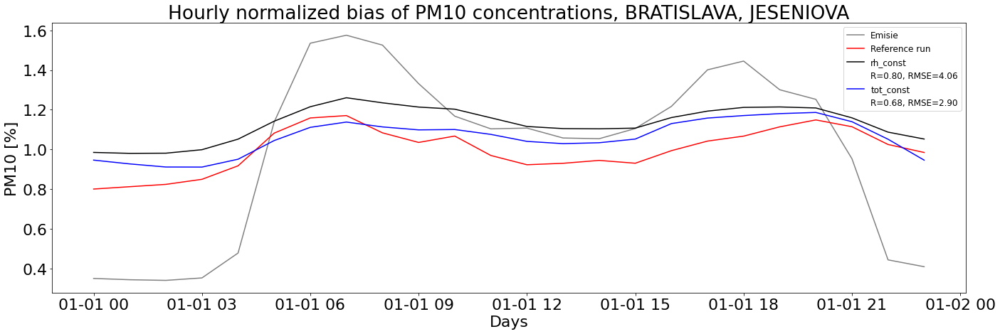

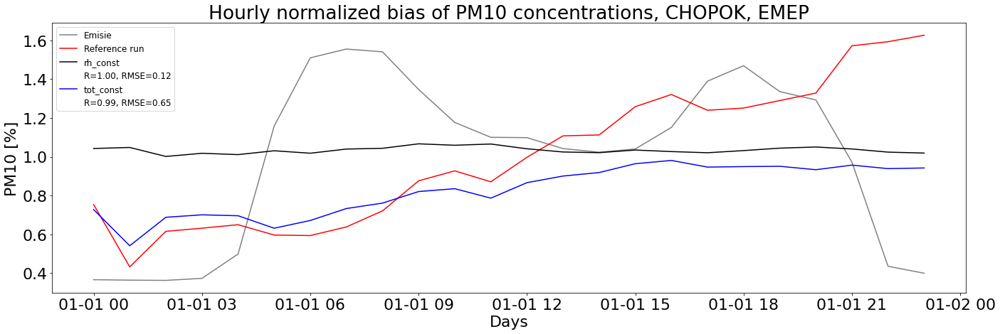

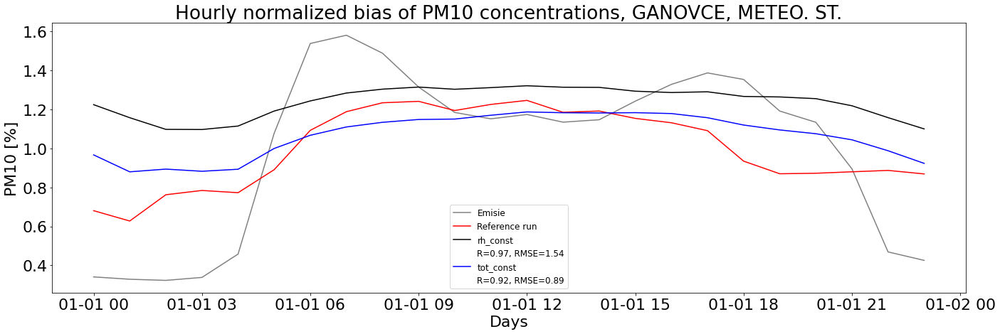

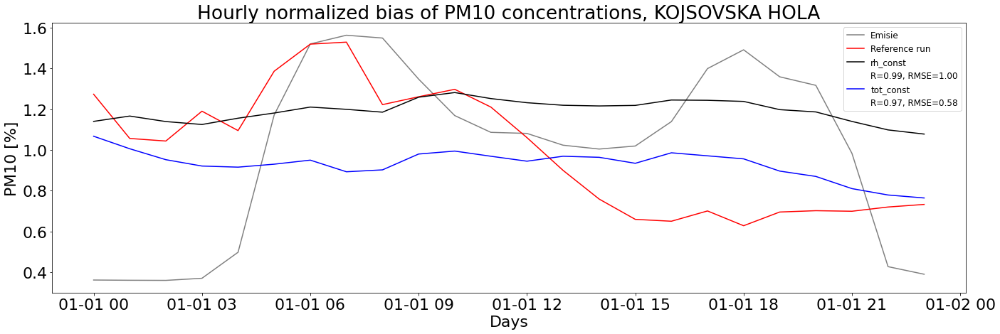

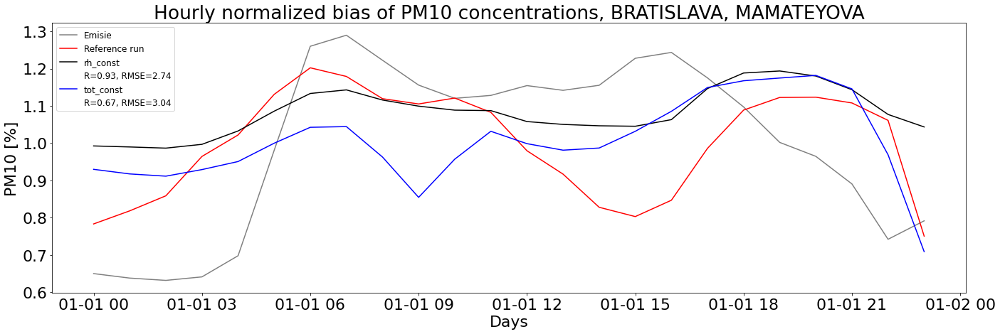

...

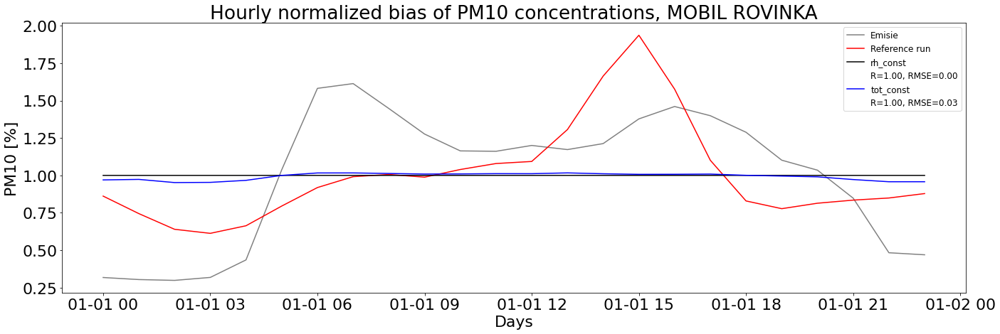

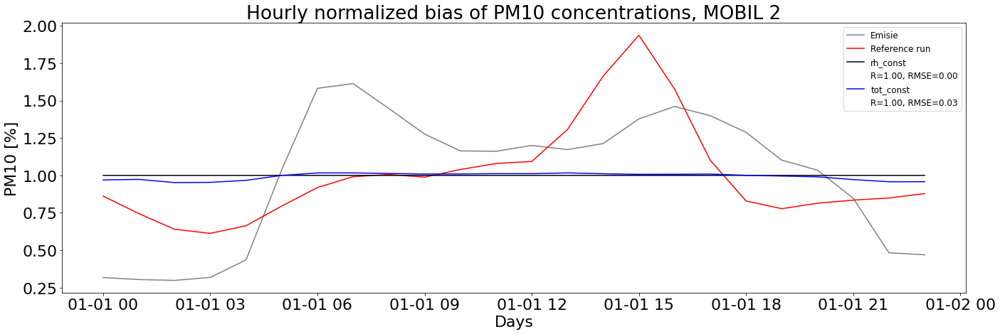

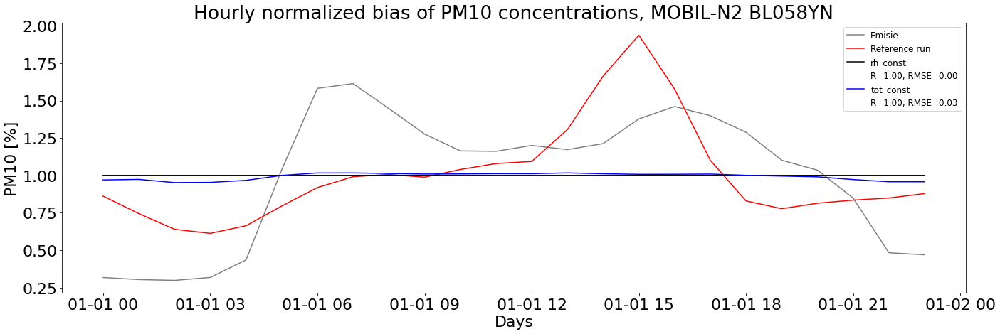

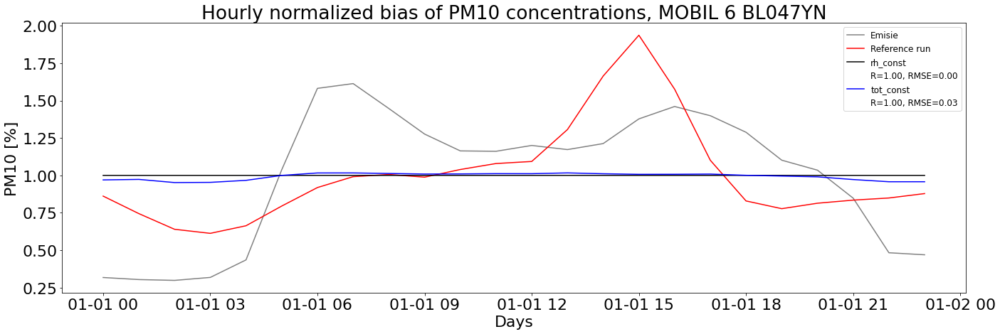

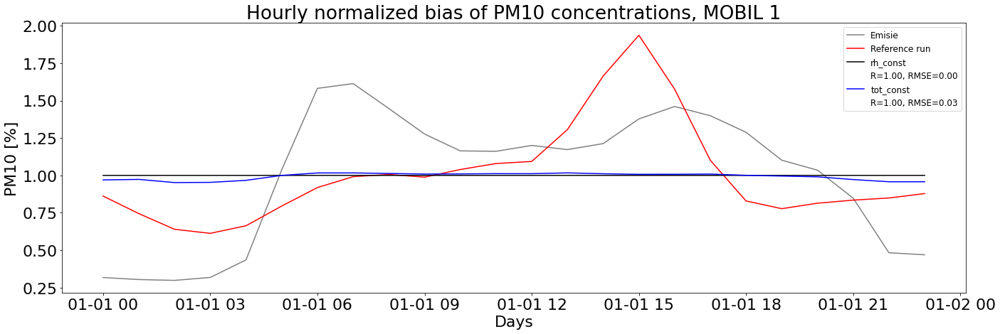

In [20]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    ref_id = data[specific[0]]['Reference'].sel(station = i).to_series()[(day_n-1)*24:day_n*24]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    emis_id = emisie_day[:(-1),x,y]
    #emis_norm = 100*(emis_id[:,0,0]-emis_id[:,0,0].mean())/emis_id[:,0,0].mean()
    emis_norm = emis_id[:,0,0]/emis_id[:,0,0].mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(ref_id.index[:], emis_norm, color = 'grey', label = 'Emisie') 
    #plt.plot(ref_id.index[:], 100*(ref_id[:]-ref_id[:].mean())/ref_id[:].mean(), color = ref_color, label = 'Reference run')
    plt.plot(ref_id.index[:], ref_id[:]/ref_id[:].mean(), color = ref_color, label = 'Reference run')

    for s in specific:
        mod_id = data[s]['Other'].sel(station = i).to_series()[(day_n-1)*24:day_n*24]
        #diff_id = 100*(ref_id-mod_id)/ref_id.mean()
        podiel_id = (ref_id)/mod_id
        
        stat_corr = mod_id.corr(ref_id)
        stat_diff = np.array((mod_id - ref_id))
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        #plt.plot(obs_id.index[(plot_from-1)*24:plot_until*24], mod_id[(plot_from-1)*24:plot_until*24], color = color_list[s], label = '{}'.format(s))
        plt.plot(ref_id.index[:], podiel_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Hourly normalized bias of {0} concentrations, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [%]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()
    

### Konstanta K(t)

C_full/C_konst = K(t)E(t)


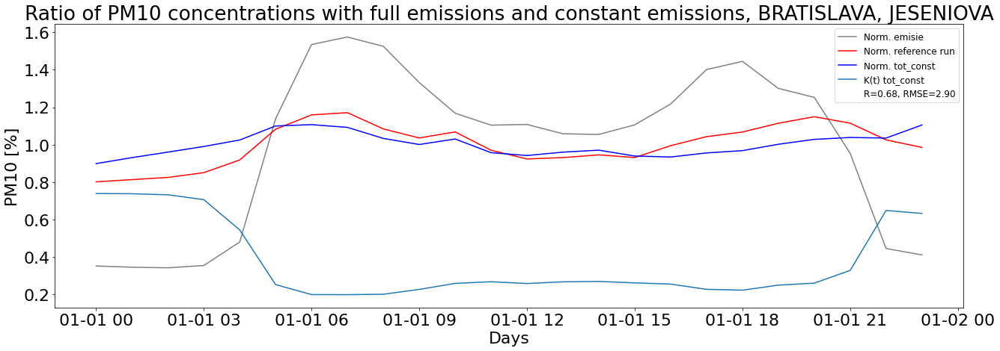

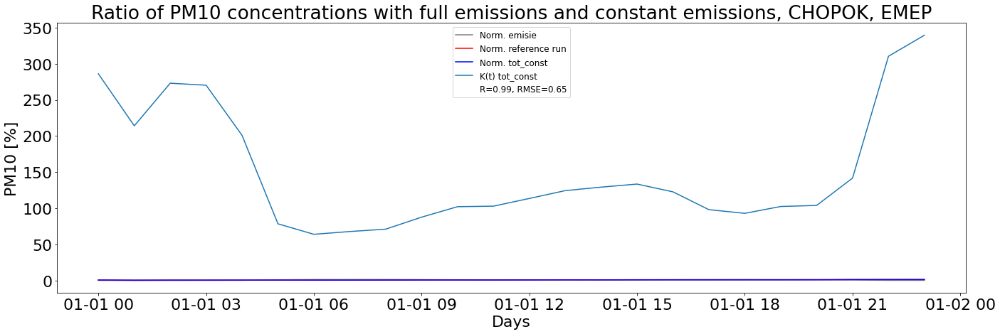

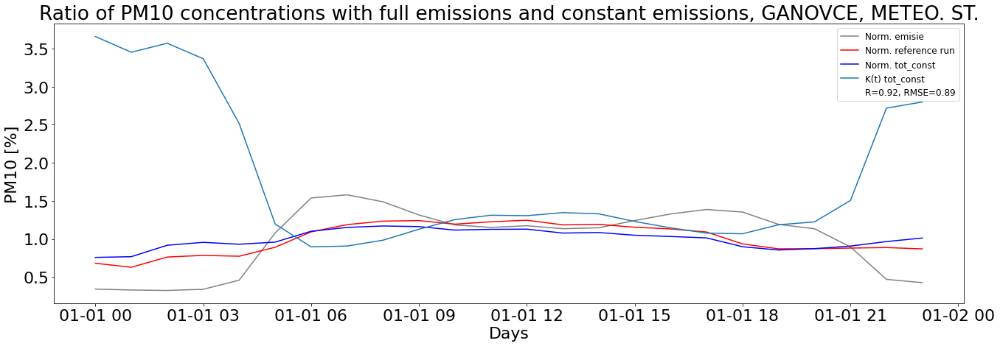

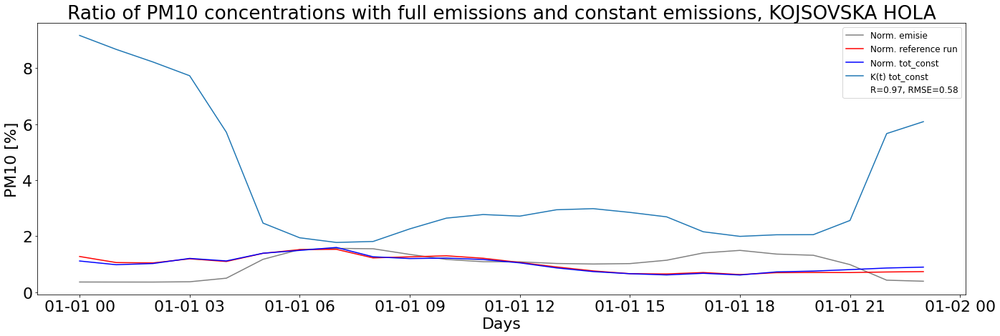

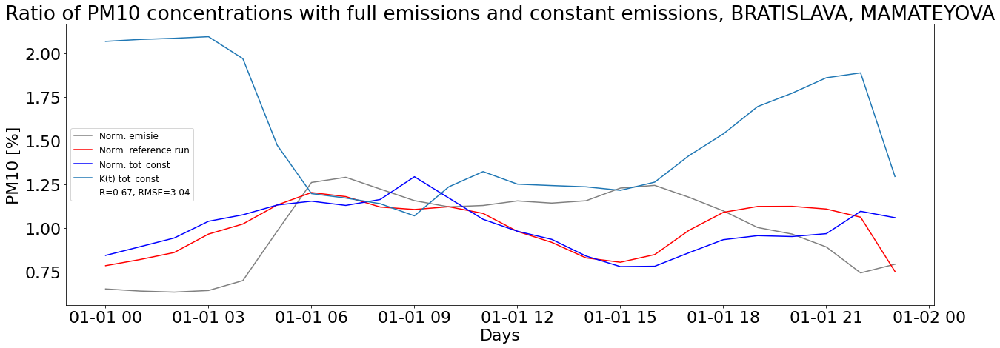

...

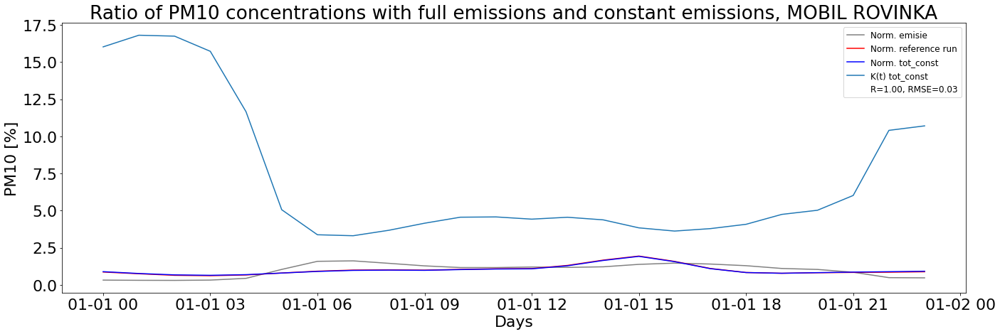

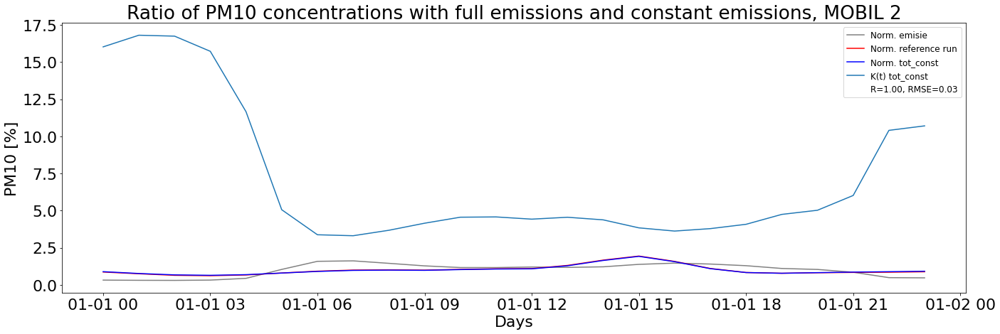

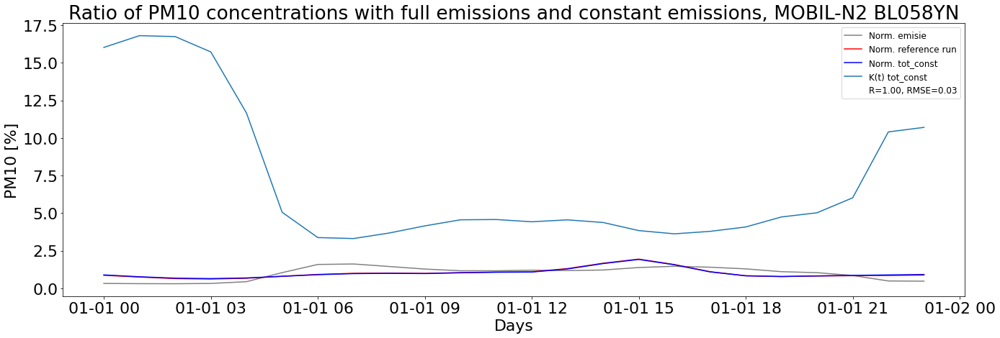

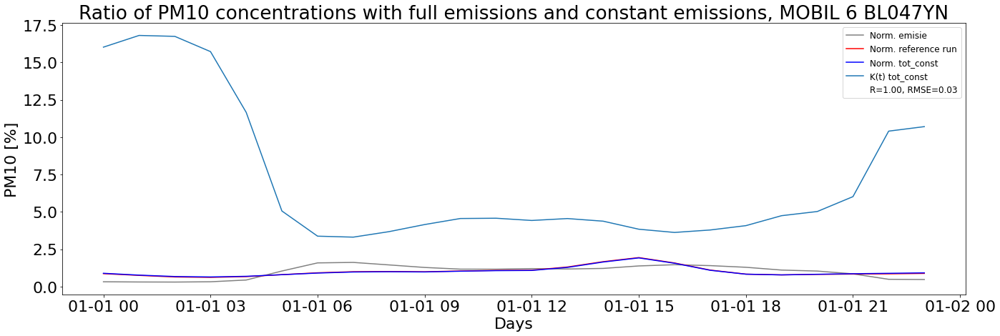

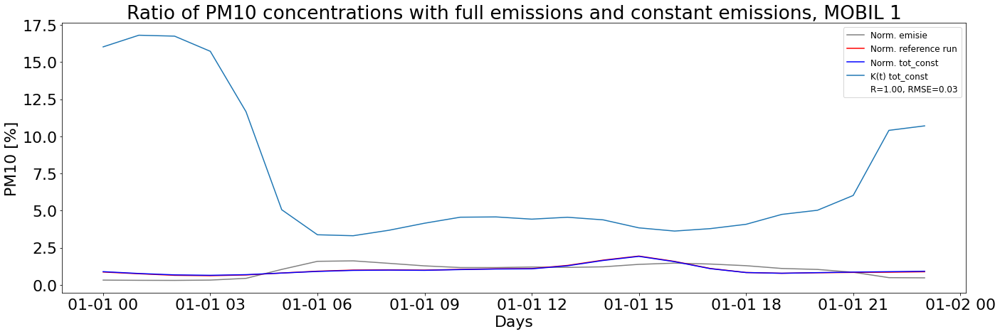

In [24]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    ref_id = data[specific[0]]['Reference'].sel(station = i).to_series()[(day_n-1)*24:day_n*24]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    emis_id = emisie[:(-1),x,y]
    emis_norm = emis_id[:,0,0]/emis_id[:,0,0].mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(ref_id.index[:], emis_norm, color = 'grey', label = 'Norm. emisie') 
    plt.plot(ref_id.index[:], ref_id[:]/ref_id[:].mean(), color = ref_color, label = 'Norm. reference run')
    #for s in specific:
    if 1<2:
        s = 'tot_const'
        mod_id = data[s]['Other'].sel(station = i).to_series()[(day_n-1)*24:day_n*24]
        ratio_id = (ref_id/mod_id)
        K = ratio_id/emis_id[:,0,0]
        #diff_id = 100*(ref_id)/mod_id
        
        stat_corr = mod_id.corr(ref_id)
        stat_diff = np.array((mod_id - ref_id))
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        #plt.plot(obs_id.index[(plot_from-1)*24:plot_until*24], mod_id[(plot_from-1)*24:plot_until*24], color = color_list[s], label = '{}'.format(s))
        #plt.plot(ref_id.index[:], ratio_id, color = color_list[s], label = 'ratio {0}'.format(s))
        plt.plot(ref_id.index[:], mod_id/mod_id.mean(), color = color_list[s], label = 'Norm. {0}'.format(s))
        plt.plot(ref_id.index[:], K, label = 'K(t) {0}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Ratio of {0} concentrations with full emissions and constant emissions, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [%]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()
    

### Priemerne hodnoty pre stanice

Priemerne hodnoty C_full/C_const, K a emisii pre jednotlive stanice za vybrane obdobie

In [81]:
#emisie
start_day = '2017-06-01 00:00:00'
end_day = '2017-06-30 23:59:59'
season = 'jar'

n_start_day = doy.day_of_year(start_day)
n_end_day = doy.day_of_year(end_day)
n_days = n_end_day - n_start_day + 1

ref = xr.open_dataset(ref_path)
cmaq_to_datetimes(ref)               
#ref_day = ref.resample({'TSTEP':'D'}).mean()

#ref_day = ref['PM10'].sel(TSTEP=slice(start_day, end_day)).groupby('TSTEP.hour').mean()
ref_day = ref['PM10'].sel(TSTEP=ref['PM10'].TSTEP.dt.month.isin(season_months[my_season])).groupby('TSTEP.hour').mean()

tot_const = xr.open_dataset(other_path[0])
cmaq_to_datetimes(tot_const)               
#tot_const_day = tot_const.resample({'TSTEP':'D'}).mean()
tot_const_day = tot_const['PM10'].sel(TSTEP=ref['PM10'].TSTEP.dt.month.isin(season_months[my_season])).groupby('TSTEP.hour').mean()

#rh_const = xr.open_dataset(other_path[0])
#cmaq_to_datetimes(rh_const)               
#rh_const_day = rh_const.resample({'TSTEP':'D'}).mean()
#rh_const_day = rh_const['PM10'].sel(TSTEP=slice(start_day, end_day)).groupby('TSTEP.hour').mean()

#times=pd.date_range(start=start_date, end=end_date, freq='H')
#emisie.coords['TSTEP']=times

#(n_start_day-1)*24 
#n_end_day*24
#emisie_day = emisie.resample({'TSTEP':'D'}).mean()
emisie_day = emisie_pm10.sel(TSTEP=emisie_pm10.TSTEP.dt.month.isin(season_months[my_season])).groupby('TSTEP.hour').mean()



NameError: name 'emisie' is not defined

In [92]:
save = False
ID = list(stat_all.index.values)[1:]

#tot_const['PM10'].sel(TSTEP=slice(start_day, end_day)).groupby('TSTEP.hour').mean()

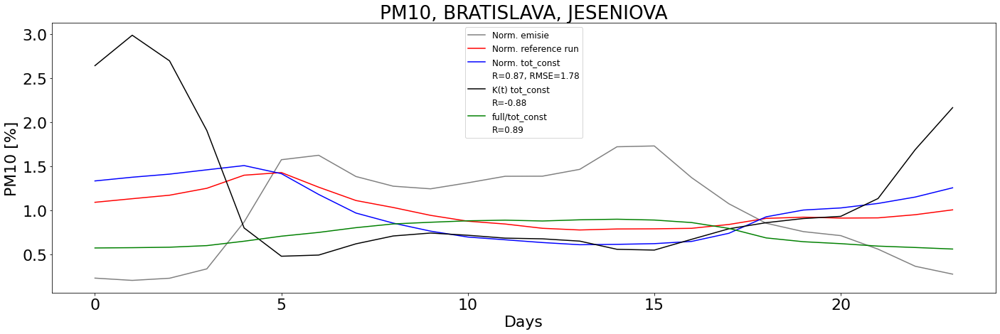

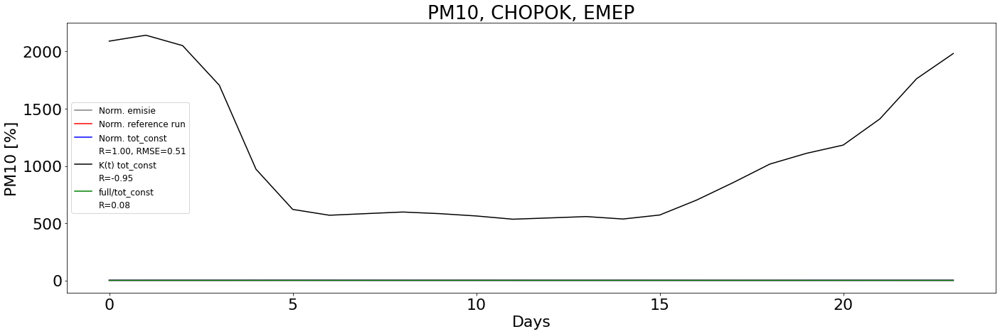

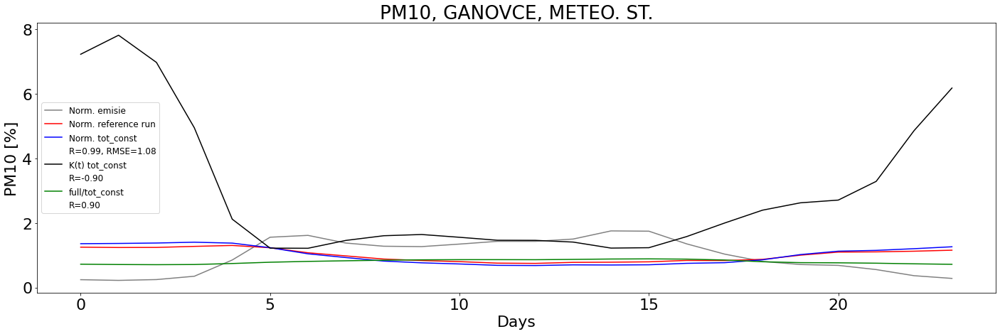

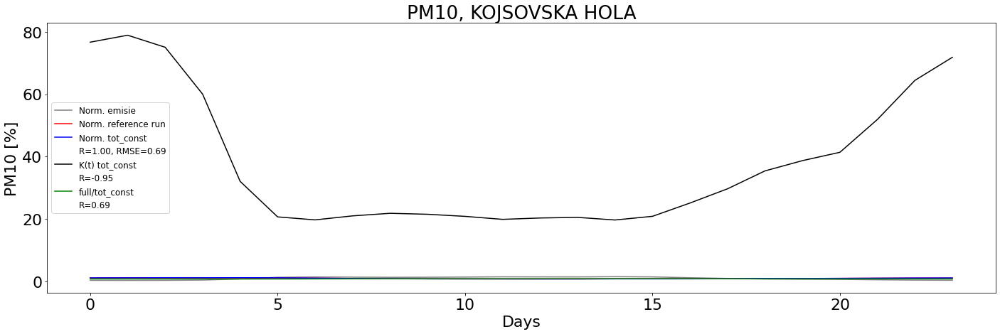

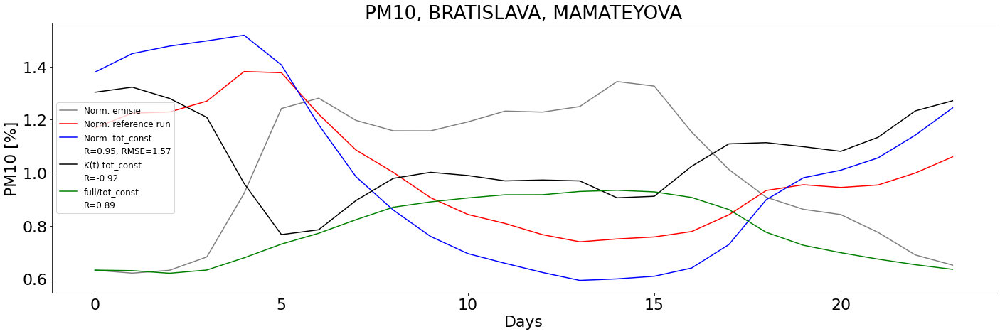

...

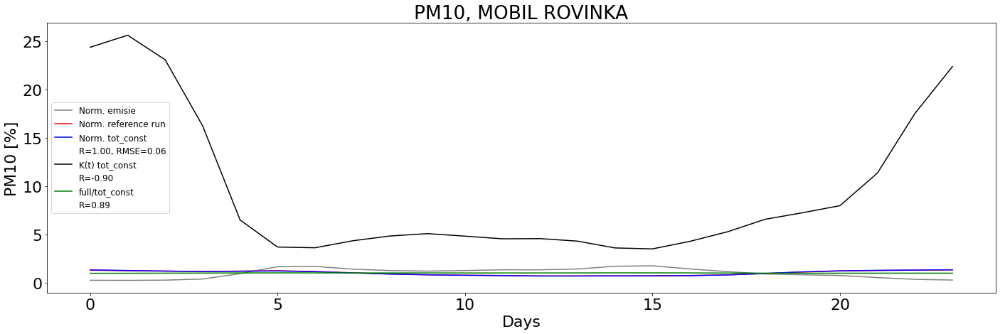

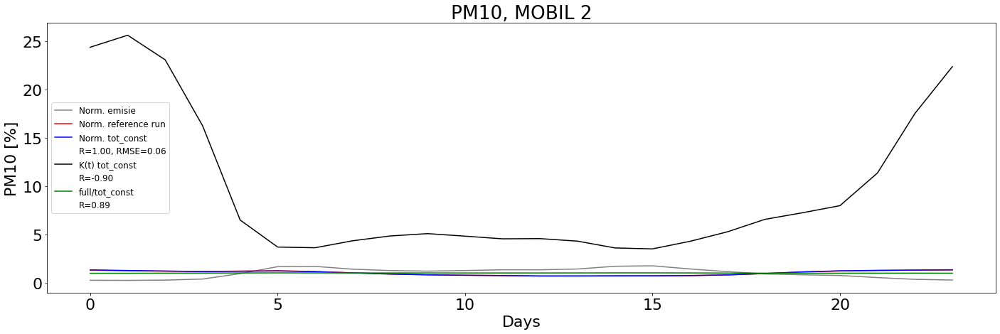

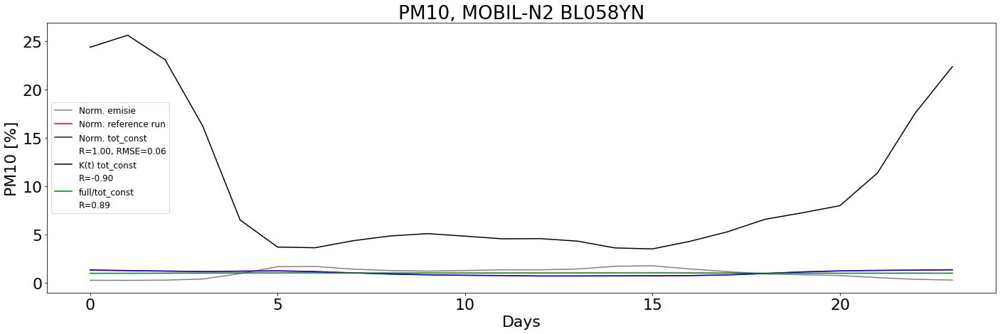

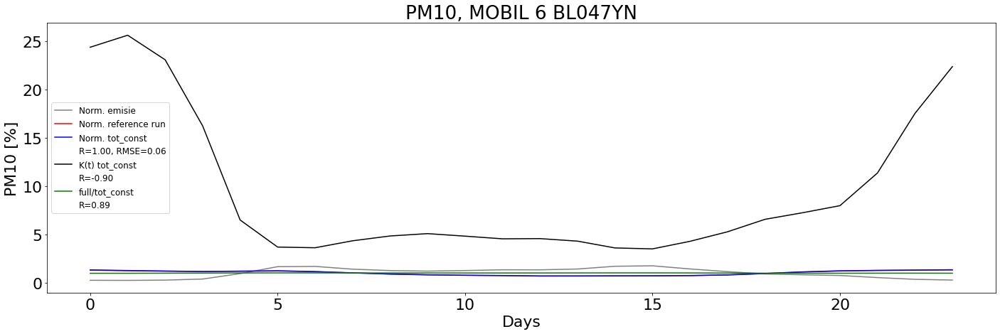

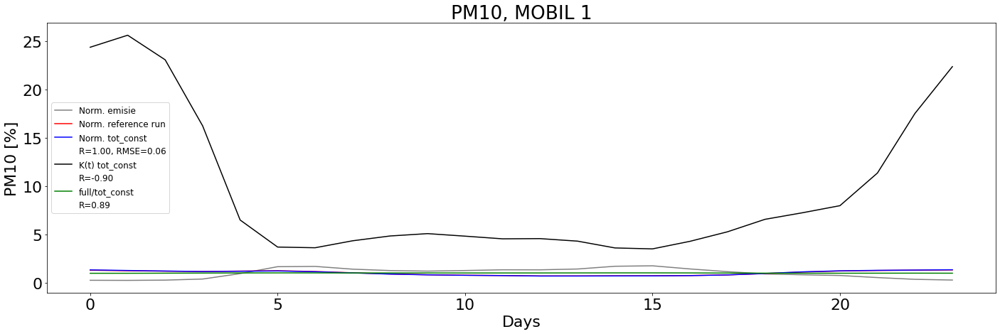

In [93]:
if save:
    print('Plots will be saved at:{}'.format(save_path))

for i in ID:    
    #ref_id = data[specific[0]]['Reference'].to_series()[(n_start_day-1)*24, n_end_day*24]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    ref_id = ref_day[:,0,x,y]
    emis_id = emisie_day[:,x,y]

    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(ref_id['hour'], emis_id[:,0,0]/emis_id[:,0,0].mean(), color = 'grey', label = 'Norm. emisie') 
    plt.plot(ref_id['hour'], ref_id[:,0,0]/ref_id[:,0,0].mean(), color = ref_color, label = 'Norm. reference run')
    
    mod_id = tot_const_day[:,0,x,y]
    s = 'tot_const'
    #mod_id_rh_const = tot_const_day[:,x,y]
    
    ratio_id = (ref_id/mod_id)
    K = ratio_id/emis_id
    
    stat_corr = mod_id.to_series().corr(ref_id.to_series())
    stat_diff = np.array((mod_id - ref_id))
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan
        
    K_corr = K.to_series().corr(emis_id.to_series())
    ratio_corr = ratio_id.to_series().corr(emis_id.to_series())
        
    plt.plot(ref_id['hour'], mod_id[:,0,0]/mod_id[:,0,0].mean(), color = color_list[s], label = 'Norm. {0}'.format(s))
    plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))
    plt.plot(ref_id['hour'], K[:,0,0], label = 'K(t) {0}'.format(s), color = 'black')
    plt.plot([], [], ' ', label='R={:0.2f}'.format(K_corr))
    plt.plot(ref_id['hour'], ratio_id[:,0,0], label = 'full/{0}'.format(s), color = 'green')
    plt.plot([], [], ' ', label='R={:0.2f}'.format(ratio_corr))

    plt.legend(fontsize=12)                
    plt.title('{0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [%]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()
    

## Rozdiely koncentracii na mape

cop
2160


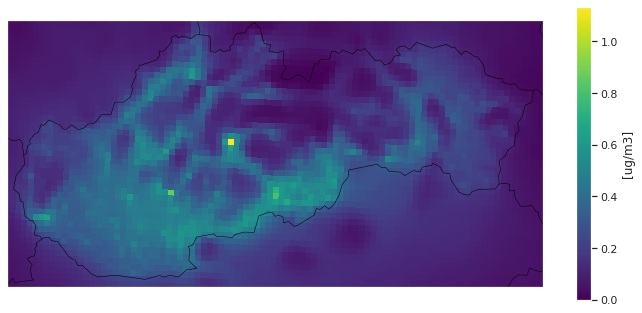

rh_const
2160


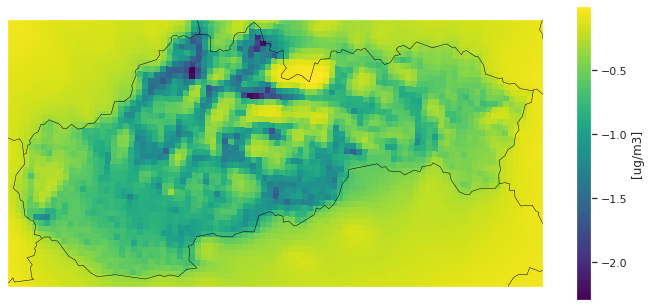

In [142]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'zima'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017'}

#day = 18
ref = xr.open_dataset(ref_path)
cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()


#for s in specific:
for i, key in enumerate(specific[0:2]):
    print(key)
    other = xr.open_dataset(other_path[key])
    cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel[v]))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    #diff = 100*(other_day[v][day,0,:,:] - ref_day[v][day,0,:,:])/ref_day[v][day,0,:,:]
    diff = (other_sel[v][:,0,:,:] - ref_sel[v][:,0,:,:]).mean(axis = 0)
    diff_norm = (100*(other_sel[v][:,0,:,:] - ref_sel[v][:,0,:,:])/(ref_sel[v][:,0,:,:])).mean(axis = 0)
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'black')
    cmap = plt.get_cmap('viridis') 
    #im = mapb.pcolormesh(lon, lat, diff, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, diff, cmap=cmap,latlon=True)
    
    cb=plt.colorbar(label='[ug/m3]')
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/diff_{0}_map_SR_{1}_{2}_2.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


In [45]:
ref_day[v][0,0,:,:]


<xarray.DataArray 'PM10' (ROW: 103, COL: 184)>
array([[ 1.5579237,  1.5900918,  1.6959877, ..., 17.195498 , 16.229427 ,
        16.390923 ],
       [ 1.5463909,  1.6918405,  1.6993507, ..., 18.134647 , 17.475409 ,
        17.028687 ],
       [ 1.8101286,  1.8098556,  1.7666354, ..., 19.14416  , 19.307354 ,
        19.679504 ],
       ...,
       [11.699868 , 11.880971 , 12.1005125, ..., 21.028366 , 20.885937 ,
        20.67557  ],
       [11.684808 , 11.795418 , 11.916833 , ..., 20.74016  , 20.7268   ,
        20.621244 ],
       [11.703435 , 11.768494 , 11.866105 , ..., 20.177183 , 20.233568 ,
        20.23913  ]], dtype=float32)
Coordinates:
    TSTEP    datetime64[ns] 2017-01-01
Dimensions without coordinates: ROW, COL

## Korelacia koncentracii na mape

cop
8760


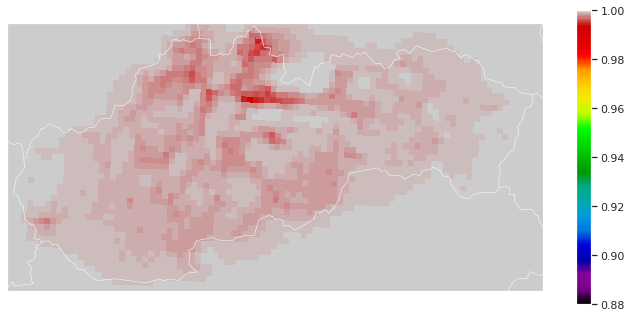

In [143]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'rok'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017'}

#day = 18
ref = xr.open_dataset(ref_path)
cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()


#for s in specific:
for i, key in enumerate(specific[0:1]):
    print(key)
    other = xr.open_dataset(other_path[key])
    cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel[v]))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    corr=xr.corr(ref_sel[v][:,0,:,:], other_sel[v][:,0,:,:], dim='TSTEP')
    diff = 100*(other_day[v][day,0,:,:] - ref_day[v][day,0,:,:])/ref_day[v][day,0,:,:]
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'white')
    cmap = plt.get_cmap('nipy_spectral') 
    im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    #im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True)
    
    cb=plt.colorbar()
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/correlation_{0}_map_SR_{1}_{2}_2.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


In [75]:
my_season = 'rok'
#other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))

other_sel

<xarray.DataArray 'PM10' (TSTEP: 8760, LAY: 1, ROW: 103, COL: 184)>
[166019520 values with dtype=float32]
Coordinates:
  * TSTEP    (TSTEP) datetime64[ns] 2017-01-01 ... 2017-12-31T23:00:00
Dimensions without coordinates: LAY, ROW, COL
Attributes:
    long_name:  PM10            
    units:      ug/m3           
    var_desc:   ASOIL[1] + ACORS[1] + PM25[0]                                ...

## Korelacia emisii na mape

cop
8760


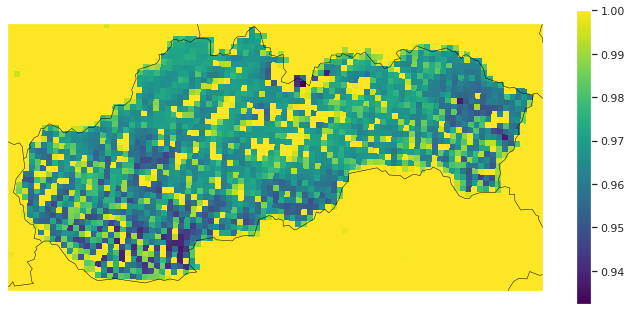

rh_const
8760


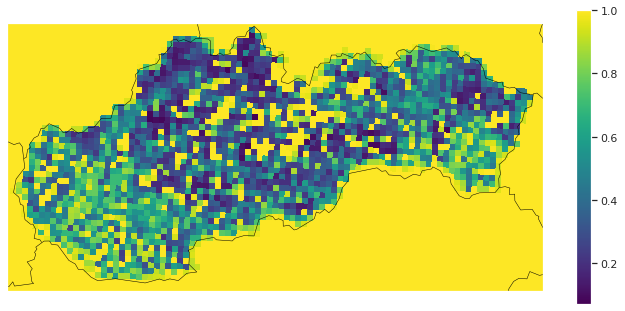

In [123]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'rok'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017'}

#day = 18
ref = emisie_pm10['ref']
#cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()


#for s in specific:
for i, key in enumerate(emisie_list[1:3]):
    print(key)
    other = emisie_pm10[key]
    #cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    corr=xr.corr(ref_sel[:,:,:], other_sel[:,:,:], dim='TSTEP')
    #diff = 100*(other_day[v][day,0,:,:] - ref_day[v][day,0,:,:])/ref_day[v][day,0,:,:]
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'black')
    cmap = plt.get_cmap('viridis') 
    #im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True)
    
    cb=plt.colorbar()
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/corr_emisie_{0}_map_SR_{1}_{2}.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


## rmse emisii na mape

cop
8760


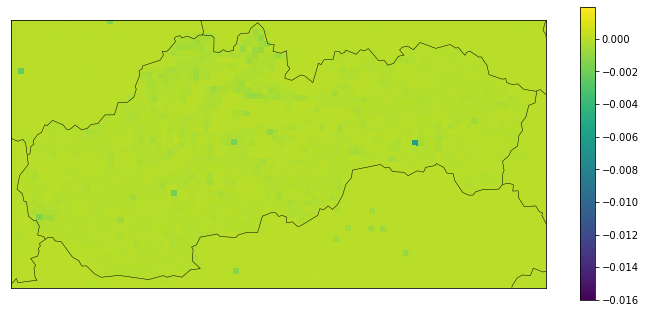

rh_const
8760


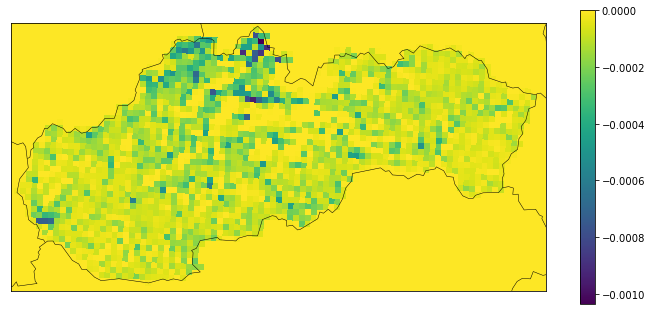

In [11]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'rok'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017'}

#day = 18
ref = emisie_pm10['ref']
#cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()


#for s in specific:
for i, key in enumerate(emisie_list[1:3]):
    print(key)
    other = emisie_pm10[key]
    #cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    #corr=xr.corr(ref_sel[:,:,:], other_sel[:,:,:], dim='TSTEP')
    mean = ref_sel.mean(axis = 0)
    diff = (other_sel[:,:,:] - ref_sel[:,:,:])
    rmse = np.sqrt(np.sum(diff**2,axis = 0)/len(diff))
    rmse_norm = 100*rmse/mean
    mge = (np.sum(np.abs(diff),axis = 0)/len(diff))
    mge_norm = 100*mge/mean
    bias = np.sum(diff, axis = 0)/len(diff)
    #diff = 100*(other_day[v][day,0,:,:] - ref_day[v][day,0,:,:])/ref_day[v][day,0,:,:]
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'black')
    cmap = plt.get_cmap('viridis') 
    #im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, bias, cmap=cmap,latlon=True)
    
    cb=plt.colorbar()
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/bias_emisie_{0}_map_SR_{1}_{2}.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


In [36]:
ref_sel

<xarray.DataArray 'PM10' (TSTEP: 8760, ROW: 103, COL: 184)>
array([[[0.06051393, 0.06705536, 0.01682146, ..., 0.24819729,
         0.25934654, 0.3056224 ],
        [0.05460269, 0.06275688, 0.01970082, ..., 0.2599488 ,
         0.2366592 , 0.19362791],
        [0.07735021, 0.07518189, 0.02774988, ..., 0.23926497,
         0.31743762, 0.40687096],
        ...,
        [1.3778449 , 0.25089565, 0.24332349, ..., 0.16271728,
         0.14645758, 0.06028961],
        [0.08236148, 0.06658391, 0.05225041, ..., 0.10810536,
         0.10630116, 0.07473485],
        [0.03025458, 0.02720558, 0.02420717, ..., 0.06741562,
         0.07321257, 0.07669342]],

       [[0.0578956 , 0.06398095, 0.01613808, ..., 0.24799527,
         0.25914252, 0.305394  ],
        [0.05196493, 0.05943675, 0.01872311, ..., 0.25972077,
         0.23645747, 0.19347575],
        [0.07380395, 0.0708849 , 0.02625446, ..., 0.23908593,
         0.31721073, 0.40659127],
...
        [1.4143004 , 0.26384982, 0.2616189 , ..., 0.17956492,
         0.16188496, 0.06597713],
        [0.08712883, 0.07228367, 0.06337509, ..., 0.11970601,
         0.11761015, 0.08230903],
        [0.03251779, 0.02981634, 0.02975433, ..., 0.07470714,
         0.08106641, 0.08473769]],

       [[0.07040755, 0.07880637, 0.01936638, ..., 0.25419226,
         0.26560563, 0.31297547],
        [0.06419968, 0.07510076, 0.02322349, ..., 0.26589367,
         0.24217826, 0.19797614],
        [0.08951522, 0.09055276, 0.03304396, ..., 0.23266219,
         0.31187293, 0.40252954],
        ...,
        [1.2222269 , 0.2302773 , 0.22990349, ..., 0.1662047 ,
         0.1502532 , 0.06208121],
        [0.07941489, 0.06605923, 0.05522076, ..., 0.11099795,
         0.10913815, 0.07679009],
        [0.03110882, 0.0281297 , 0.02590307, ..., 0.0692623 ,
         0.07519802, 0.07871667]]], dtype=float32)
Coordinates:
  * TSTEP    (TSTEP) datetime64[ns] 2017-01-01 ... 2017-12-31T23:00:00
  * ROW      (ROW) float64 0.0 1.0 2.0 3.0 4.0 ... 98.0 99.0 100.0 101.0 102.0
  * COL      (COL) float64 0.0 1.0 2.0 3.0 4.0 ... 179.0 180.0 181.0 182.0 183.0

# NO2

In [5]:
v = 'NO2'
ref_path = '/data/oko/dusan/POST/WB_2020_{0}_2017'.format(v)
other_path = ['/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_{0}_2017'.format(v), 
              '/data/oko/dusan/POST/WB_const_{0}_2017'.format(v)]

for i in range(0, len(specific)):
    print(specific[i])
    stat[specific[i]], data[specific[i]] = vali.comparison(ref_path, other_path[i], ref_model_name, other_model_name[i], ref_grid_name, other_grid_name[i], start_date, end_date, v)
    

cop
Comparison of NO2 done in 42.10295033454895 seconds
rh_const
Comparison of NO2 done in 29.671226978302002 seconds


In [6]:
#data['rh_const'].sel(time = data['rh_const'].time.dt.month.isin([3,4,5]))
#model ma coverage vsade, takze ked chcem vybrat len stanice ktore pouzivam aj pri obs, tak treba zobrat zoznam kde sa vylucia
#stanice s nulovym pokrytim (z validacneho scriptu)
ID_B = [11813,11916,11952,11958,99111,99134,99215,99224,99246,99252,99281,99351,99401,99403,99404]
len(ID_B)

15

## Statistika (R, RMSE, BIAS, MGE) s referencnym runom

In [66]:
stat_all = stat[specific[0]][['name','loc','type']].copy()
stat_all.head()

for s in statistiky:
    for i in specific:
        stat_all['{0}_{1}'.format(s,i)] = stat[i][s]

#stat_all.head()
stat_all

,name,loc,type,bias_tot_const,bias_rh_const,mge_tot_const,mge_rh_const,rmse_tot_const,rmse_rh_const,r_tot_const,r_rh_const
all,all,all,all,0.273811,0.720648,0.278326,1.22065,0.464109,2.18881,0.998369,0.911887
11813,"BRATISLAVA, JESENIOVA",S,B,0.586508,1.82803,0.587233,2.94272,0.828872,4.61156,0.998656,0.873853
11916,"CHOPOK, EMEP",R,B,0.0406358,0.0398361,0.0407455,0.16903,0.0600346,0.292434,0.999483,0.974972
11952,"GANOVCE, METEO. ST.",R,B,0.401525,1.01743,0.402285,1.7321,0.54862,2.62348,0.997583,0.711575
11958,KOJSOVSKA HOLA,R,B,0.119381,0.184634,0.119832,0.369469,0.218938,0.550924,0.998981,0.978938
99111,"BRATISLAVA, MAMATEYOVA",U,B,0.517863,1.73425,0.517914,2.64747,0.785183,4.17544,0.998803,0.906624
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,0.586508,1.82803,0.587233,2.94272,0.828872,4.61156,0.998656,0.873853
99114,"BRATISLAVA, KAMENNE NAM.",U,B,0.586508,1.82803,0.587233,2.94272,0.828872,4.61156,0.998656,0.873853
99117,BRATISLAVA - RACA,None,None,0.343884,0.932997,0.344327,1.65863,0.522563,2.65404,0.998407,0.898916
99122,"SENICA, HVIEZDOSLAVOVA",U,T,0.125468,0.396297,0.128825,0.795322,0.191994,1.16076,0.999083,0.944472


## Priprava emisii

In [7]:
emisie_list = ['ref','cop', 'rh_const']
emisie_file = {'ref':'WB_2017_d02', 'rh_const':'WB_2017_const', 'cop':'WB_2017_CAMS_13_res_heat'}
emisie_no2 = {}

for e in emisie_list:
    print(e)
    start_time = time.time()
    emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],start_date[:10]))
    emisie_no2[e] = emisie_full[v][:(-1),:,:,:].sum(axis=1)
    
    for i in range(n_start+1,n_days + 1):
        date = doy.date_from_day(i, start_date[0:4])
        emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],date))
        emisie_new = emisie_full[v][:(-1),:,:,:].sum(axis=1)
        emisie_no2[e] = xr.concat([emisie_no2[e], emisie_new], 'TSTEP')

    print('{0}-{1} done in {2} s'.format(start_date,date,time.time()-start_time))

ref
2017-01-01 00:00:00-2017-12-31 done in 182.34181475639343 s
cop
2017-01-01 00:00:00-2017-12-31 done in 154.1350290775299 s
rh_const
2017-01-01 00:00:00-2017-12-31 done in 136.964852809906 s


In [8]:
times=pd.date_range(start=start_date, end=end_date, freq='H')
for e in emisie_list:
    emisie_no2[e].coords['TSTEP']=times
    emisie_no2[e].coords['ROW'] = np.linspace(0,102,103)
    emisie_no2[e].coords['COL'] = np.linspace(0,183,184)
    
emisie_no2

{'ref': <xarray.DataArray 'NO2' (TSTEP: 8760, ROW: 103, COL: 184)>
 array([[[2.08194455e-04, 2.41922506e-04, 5.54252547e-05, ...,
          8.67905692e-05, 9.00121886e-05, 1.05974912e-04],
         [2.03009200e-04, 2.51486141e-04, 7.41425829e-05, ...,
          1.01493897e-04, 9.15875353e-05, 7.84095391e-05],
         [2.70388729e-04, 3.13142373e-04, 1.09605862e-04, ...,
          2.55037274e-04, 2.86543160e-04, 3.21757165e-04],
         ...,
         [8.29433650e-02, 4.71605104e-04, 4.55454981e-04, ...,
          2.36293228e-04, 2.19285663e-04, 1.47227125e-04],
         [1.71085790e-04, 1.43123223e-04, 1.18832446e-04, ...,
          1.69133156e-04, 1.68414059e-04, 1.40265911e-04],
         [6.95386479e-05, 6.26175897e-05, 5.62031455e-05, ...,
          1.10289300e-04, 1.18891076e-04, 1.22048441e-04]],
 
        [[1.70048093e-04, 1.95535962e-04, 4.59705807e-05, ...,
          8.27847980e-05, 8.59981665e-05, 1.01537480e-04],
         [1.65980673e-04, 2.01949515e-04, 6.04180277e-05, ...,

In [ ]:
emis_stanice_no2 = {}

for e in emisie_list:
    emis_stanice_no2[e] = pd.DataFrame()
    emis_stanice_no2[e]['season'] = pd.Series(season)
    for i in ID:
        x = stanice['x'].loc[stanice.ii == i].item()
        y = stanice['y'].loc[stanice.ii == i].item()
        emis_stanice_no2[e][i] = pd.Series(emisie_no2[e][:,x,y])

    new_index = pd.date_range(start_date, end_date , freq='H')
    emis_stanice_no2[e] = emis_stanice_no2[e].set_index(new_index)
    
#new_mean = emis_stanice_no2['ref'][ID_B].loc[season =='leto'].groupby(emis_stanice_no2['ref'][ID_B].loc[emis_stanice_no2['ref']['season']=='leto'].index.hour).mean()

#new_mean['daily_avrg'] = new_mean.mean(axis = 1)
#new_mean['daily_avrg']

## Emisie rocne obodbia

In [11]:
### USER INPUT
# Choose stations to plot
#ID = list(stat_all.index.values)[1:]   # all stations
ID = ID_B
#ID = [11813,11916]    # selected stations
spec_nick = 'ref'

save = True   # save the plots?  


save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)
print(ID)
import os

[11813, 11916, 11952, 11958, 99111, 99134, 99215, 99224, 99246, 99252, 99281, 99351, 99401, 99403, 99404]


Plots will be saved at:/data/teri/validacia/validated/const_emis_2017/graphs/NO2


NameError: name 'plot_from' is not defined

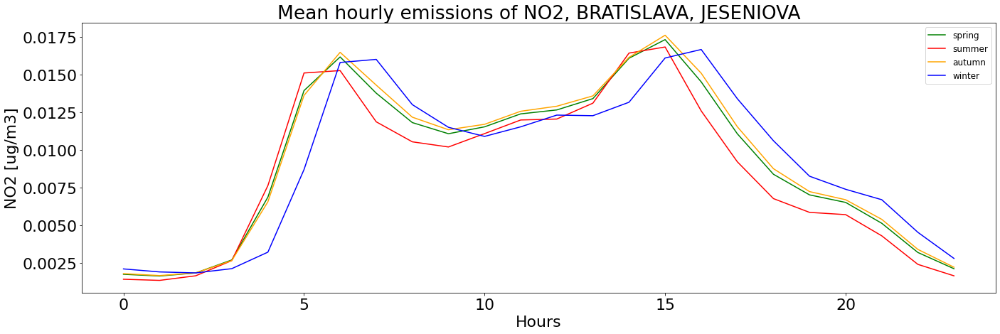

In [24]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
   
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    emis_id_jar = emisie_no2[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_no2[spec_nick].TSTEP.dt.month.isin(season_months['jar'])).groupby('TSTEP.hour').mean()
    emis_id_leto = emisie_no2[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_no2[spec_nick].TSTEP.dt.month.isin(season_months['leto'])).groupby('TSTEP.hour').mean()
    emis_id_jesen = emisie_no2[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_no2[spec_nick].TSTEP.dt.month.isin(season_months['jesen'])).groupby('TSTEP.hour').mean()
    emis_id_zima = emisie_no2[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_no2[spec_nick].TSTEP.dt.month.isin(season_months['zima'])).groupby('TSTEP.hour').mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(emis_id_jar.hour, emis_id_jar[:,0,0], color ='green', label = 'spring') 
    plt.plot(emis_id_leto.hour, emis_id_leto[:,0,0], color ='red', label = 'summer')
    plt.plot(emis_id_jesen.hour, emis_id_jesen[:,0,0], color ='orange', label = 'autumn') 
    plt.plot(emis_id_zima.hour, emis_id_zima[:,0,0], color ='blue', label = 'winter')

    plt.legend(fontsize=12)                
    plt.title('Mean hourly emissions of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{3}_{4}_MH{5}-{6}_seasons.png'.format(save_path,nick, v, i), dpi=300)                
    plt.show()                
    plt.close() 

In [39]:
emis_leto_mean

0   11813    1.429062e-03
    11916    3.332433e-07
    11952    7.761864e-04
    11958    2.238143e-05
    99111    2.423740e-03
                 ...     
23  99401    7.724926e-05
    99403    1.962859e-05
    99404    3.113065e-05
    99502    2.293551e-02
    99702    4.831979e-03
Length: 480, dtype: float32

## Emisie rocne obdobia staton types

In [ ]:
save = True
if save:
    print('Plots will be saved at:{}'.format(save_path))
    
emis_id_leto = emisie_no2[spec_nick].sel(ROW = 10, COL = 10, TSTEP = emisie_no2[spec_nick].TSTEP.dt.month.isin(season_months['leto'])).groupby('TSTEP.hour').mean()

#emis_leto_mean = emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='leto'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='leto'].index.hour).mean().stack()        
#emis_zima_mean = emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='zima'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='zima'].index.hour).mean().stack()        

emis_jar_mean = emis_stanice_no2[spec_nick][ID_B].loc[season =='jar'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='jar'].index.hour).mean()
emis_jar_mean['daily_avrg'] = emis_jar_mean.mean(axis = 1)

emis_leto_mean = emis_stanice_no2[spec_nick][ID_B].loc[season =='leto'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='leto'].index.hour).mean()
emis_leto_mean['daily_avrg'] = emis_leto_mean.mean(axis = 1)

emis_jesen_mean = emis_stanice_no2[spec_nick][ID_B].loc[season =='jesen'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='jesen'].index.hour).mean()
emis_jesen_mean['daily_avrg'] = emis_jesen_mean.mean(axis = 1)

emis_zima_mean = emis_stanice_no2[spec_nick][ID_B].loc[season =='zima'].groupby(emis_stanice_no2[spec_nick][ID_B].loc[emis_stanice_no2[spec_nick]['season']=='zima'].index.hour).mean()
emis_zima_mean['daily_avrg'] = emis_zima_mean.mean(axis = 1)

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

#plt.plot(emis_id_leto.hour, emis_jar_mean['daily_avrg'], color ='green', label = 'spring') 
plt.plot(emis_id_leto.hour, emis_leto_mean['daily_avrg'], color ='red', label = 'summer')
#plt.plot(emis_id_leto.hour, emis_jesen_mean['daily_avrg'], color ='orange', label = 'autumn') 
plt.plot(emis_id_leto.hour, emis_zima_mean['daily_avrg'], color ='blue', label = 'winter')

plt.legend(fontsize=12)                
plt.title('Mean hourly emissions of {0}, B'.format(v))                               
plt.xlabel('Hours')
plt.ylabel('{0} [mol/s]'.format(v))
plt.tight_layout()

if save:
    #if not os.path.exists(save_path):
     #   os.makedirs(save_path)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_full_vs_const/grafy/NO2/MH_emissions_B_winter_summer_NO2.png'.format(save_path), dpi=300)                
plt.show()                
plt.close() 

## Hodinovy chod emisii 

In [11]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

spec_nick = 'ref'

plot_from = '2017-01-06'
plot_until = '2017-01-12'  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

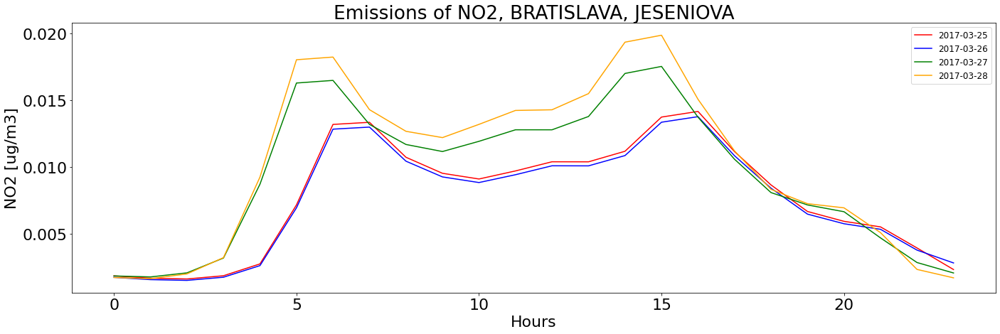

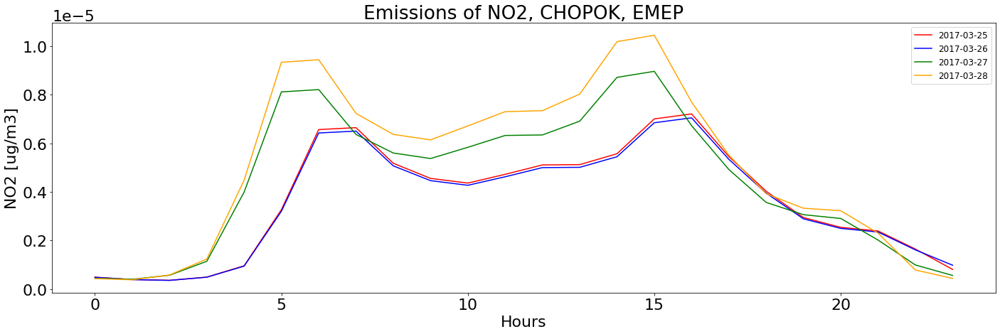

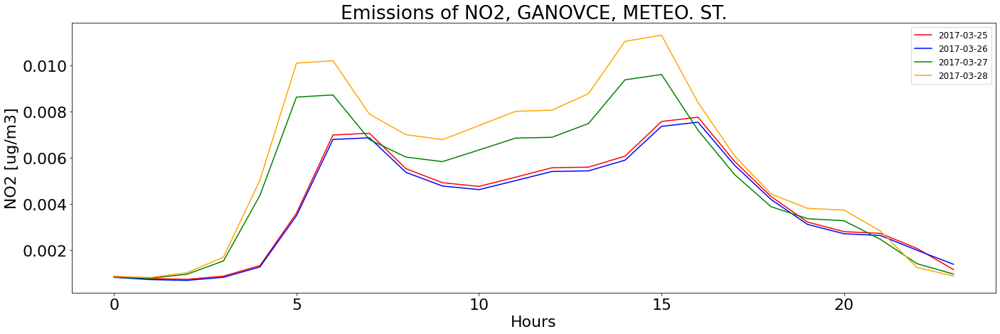

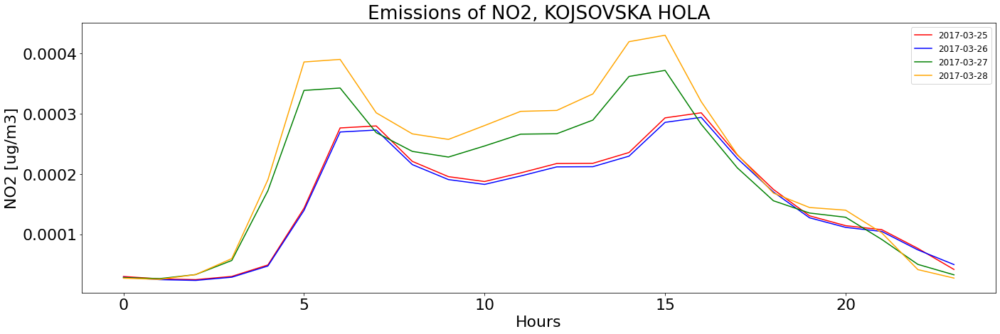

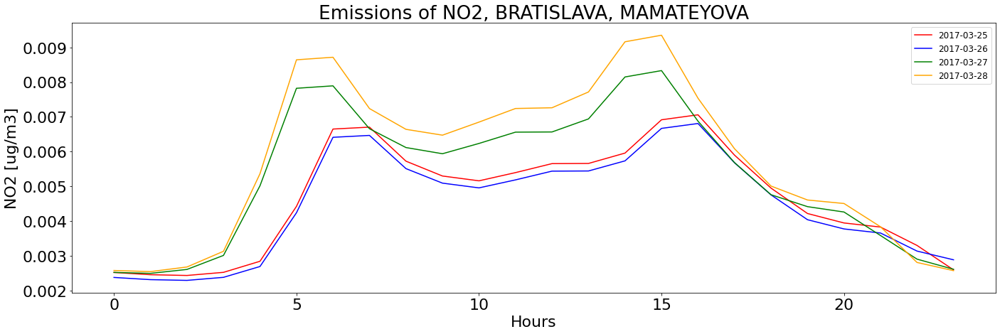

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    emis_id = emisie_no2[spec_nick].sel(ROW = x, COL = y).to_series()['2017-03-25 00:00:00':'2017-03-25 23:00:00']
    emis_id2 = emisie_no2[spec_nick].sel(ROW = x, COL = y).to_series()['2017-03-26 00:00:00':'2017-03-26 23:00:00']
    emis_id3 = emisie_no2[spec_nick].sel(ROW = x, COL = y).to_series()['2017-03-27 00:00:00':'2017-03-27 23:00:00']
    emis_id4 = emisie_no2[spec_nick].sel(ROW = x, COL = y).to_series()['2017-05-05 00:00:00':'2017-05-05 23:00:00']
    emis_id_mean = emisie_no2[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_no2[spec_nick].TSTEP.dt.month.isin(season_months['mar'])).groupby('TSTEP.hour').mean()
       
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(emis_id_mean.hour, emis_id[:], color ='red', label = '2017-03-25')  
    plt.plot(emis_id_mean.hour, emis_id2[:], color ='blue', label = '2017-03-26')
    plt.plot(emis_id_mean.hour, emis_id3[:], color ='green', label = '2017-03-27')
    plt.plot(emis_id_mean.hour, emis_id4[:], color ='orange', label = '2017-03-28')
    

    plt.legend(fontsize=12)                
    plt.title('Emissions of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Emisie rocny chod

In [20]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

spec_nick = 'ref'

plot_from = '2017-01-01 00:00:00'
plot_until = '2017-12-31 23:00:00'  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

emisie_no2['ref'].sel(ROW = x, COL = y).to_series()[plot_from:plot_until]

TSTEP                ROW   COL 
2017-01-01 00:00:00  21.0  92.0    0.001885
2017-01-01 01:00:00  21.0  92.0    0.001733
2017-01-01 02:00:00  21.0  92.0    0.001682
2017-01-01 03:00:00  21.0  92.0    0.001902
2017-01-01 04:00:00  21.0  92.0    0.002786
                                     ...   
2017-12-31 19:00:00  21.0  92.0    0.006992
2017-12-31 20:00:00  21.0  92.0    0.006272
2017-12-31 21:00:00  21.0  92.0    0.005693
2017-12-31 22:00:00  21.0  92.0    0.003889
2017-12-31 23:00:00  21.0  92.0    0.002305
Name: NO2, Length: 8760, dtype: float32

In [11]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    emis_ref = emisie_no2['ref'].sel(ROW = x, COL = y).to_series()[plot_from:plot_until]
    emis_tot = emisie_no2['tot_const'].sel(ROW = x, COL = y).to_series()[plot_from:plot_until]
    #emis_id_mean = emisie_no2['tot_const'].sel(ROW = x, COL = y, TSTEP = emisie_no2[spec_nick].TSTEP.dt.month.isin(season_months['mar'])).groupby('TSTEP.hour').mean()
       
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(emis_ref['TSTEP'], emis_ref[:], color ='red', label = 'ref')  
    plt.plot(emis_const['TSTEP'], emis_const[:], color ='blue', label = 'tot_const')
    
    plt.legend(fontsize=12)                
    plt.title('Emissions of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

TypeError: '<' not supported between instances of 'int' and 'slice'

## Rozdiely koncentracii na mape

cop
8760


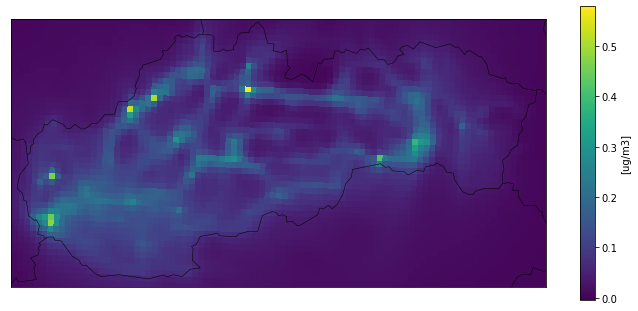

rh_const
8760


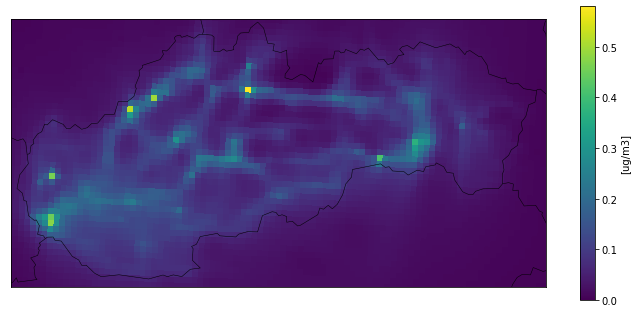

In [32]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'rok'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_NO2_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_NO2_2017'}

#day = 18
ref = xr.open_dataset(ref_path)
cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()


#for s in specific:
for i, key in enumerate(specific[0:2]):
    print(key)
    other = xr.open_dataset(other_path[key])
    cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel[v]))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    #diff = 100*(other_day[v][day,0,:,:] - ref_day[v][day,0,:,:])/ref_day[v][day,0,:,:]
    diff = (other_sel[v][:,0,:,:] - ref_sel[v][:,0,:,:]).mean(axis = 0)
    diff_norm = (100*(other_sel[v][:,0,:,:] - ref_sel[v][:,0,:,:])/(ref_sel[v][:,0,:,:])).mean(axis = 0)
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'black')
    cmap = plt.get_cmap('viridis') 
    #im = mapb.pcolormesh(lon, lat, diff, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, diff, cmap=cmap,latlon=True)
    
    cb=plt.colorbar(label='[ug/m3]')
    #cb=plt.colorbar(label='[%]')
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/diff_{0}_map_SR_{1}_{2}.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


In [16]:
other_path


{'cop': '/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_NO2_2017',
 'rh_const': '/data/oko/dusan/POST/WB_const_NO2_2017'}

## Korelacia koncentracii na mape

cop
2160


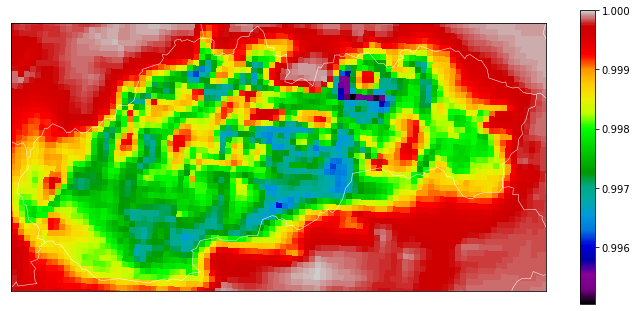

rh_const
2160


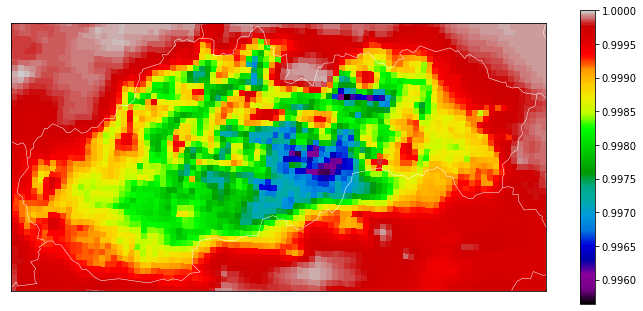

In [38]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'zima'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_NO2_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_NO2_2017'}

#day = 18
ref = xr.open_dataset(ref_path)
cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()


#for s in specific:
for i, key in enumerate(specific[0:2]):
    print(key)
    other = xr.open_dataset(other_path[key])
    cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel[v]))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    corr=xr.corr(ref_sel[v][:,0,:,:], other_sel[v][:,0,:,:], dim='TSTEP')
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'white')
    cmap = plt.get_cmap('nipy_spectral') 
    #im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True)
    
    cb=plt.colorbar()
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/correlation_{0}_map_SR_{1}_{2}.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


In [75]:
my_season = 'rok'
#other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))

other_sel

<xarray.DataArray 'PM10' (TSTEP: 8760, LAY: 1, ROW: 103, COL: 184)>
[166019520 values with dtype=float32]
Coordinates:
  * TSTEP    (TSTEP) datetime64[ns] 2017-01-01 ... 2017-12-31T23:00:00
Dimensions without coordinates: LAY, ROW, COL
Attributes:
    long_name:  PM10            
    units:      ug/m3           
    var_desc:   ASOIL[1] + ACORS[1] + PM25[0]                                ...

## Korelacia emisii na mape

cop
2160


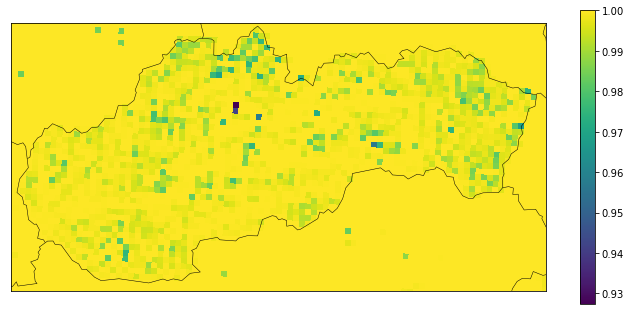

rh_const
2160


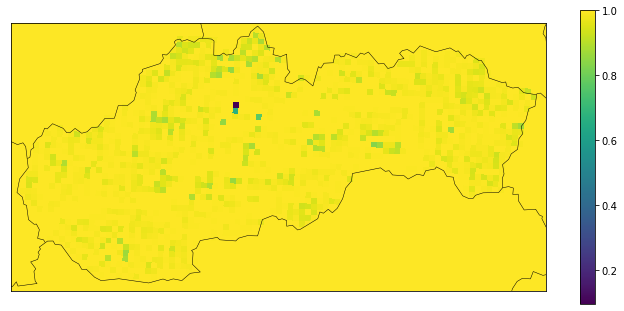

In [43]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'zima'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_NO2_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_NO2_2017'}

#day = 18
ref = emisie_no2['ref']
#cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()


#for s in specific:
for i, key in enumerate(emisie_list[1:3]):
    print(key)
    other = emisie_no2[key]
    #cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    corr=xr.corr(ref_sel[:,:,:], other_sel[:,:,:], dim='TSTEP')
    #diff = 100*(other_day[v][day,0,:,:] - ref_day[v][day,0,:,:])/ref_day[v][day,0,:,:]
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'black')
    cmap = plt.get_cmap('viridis') 
    #im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True)
    
    cb=plt.colorbar()
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/corr_emisie_{0}_map_SR_{1}_{2}.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


# PM2.5

In [144]:
v = 'PM2_5'
ref_path = '/data/oko/dusan/POST/WB_2020_PM_2017'
other_path = ['/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', '/data/oko/dusan/POST/WB_const_PM_2017']

for i in range(0, len(specific)):
    print(specific[i])
    stat[specific[i]], data[specific[i]] = vali.comparison(ref_path, other_path[i], ref_model_name, other_model_name[i], ref_grid_name, other_grid_name[i], start_date, end_date, v)
    

cop
Comparison of PM2_5 done in 3.5149295330047607 seconds
rh_const
Comparison of PM2_5 done in 3.5457019805908203 seconds


In [47]:
#data['rh_const'].sel(time = data['rh_const'].time.dt.month.isin([3,4,5]))
v

'PM2_5'

## Statistika (R, RMSE, BIAS, MGE) s referencnym runom

In [41]:
stat_all = stat[specific[0]][['name','loc','type']].copy()
stat_all.head()

for s in statistiky:
    for i in specific:
        stat_all['{0}_{1}'.format(s,i)] = stat[i][s]

#stat_all.head()
stat_all

,name,loc,type,bias_tot_const,bias_rh_const,mge_tot_const,mge_rh_const,rmse_tot_const,rmse_rh_const,r_tot_const,r_rh_const
all,all,all,all,0.0550865,0.325231,0.52167,1.00975,0.92994,1.52203,0.985916,0.961105
11813,"BRATISLAVA, JESENIOVA",S,B,0.109054,0.449497,0.824443,1.40958,1.26977,1.95385,0.982713,0.955751
11916,"CHOPOK, EMEP",R,B,0.0564163,0.121125,0.125496,0.389556,0.179807,0.552338,0.997721,0.976141
11952,"GANOVCE, METEO. ST.",R,B,0.0506741,0.323276,0.519658,0.911437,0.769967,1.24874,0.972722,0.930548
11958,KOJSOVSKA HOLA,R,B,0.0324445,0.301562,0.279655,0.728242,0.408575,0.982551,0.993881,0.966748
99111,"BRATISLAVA, MAMATEYOVA",U,B,0.0981692,0.403423,0.500978,1.16892,0.874334,1.66344,0.990954,0.965647
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,0.109054,0.449497,0.824443,1.40958,1.26977,1.95385,0.982713,0.955751
99114,"BRATISLAVA, KAMENNE NAM.",U,B,0.109054,0.449497,0.824443,1.40958,1.26977,1.95385,0.982713,0.955751
99117,BRATISLAVA - RACA,None,None,0.0658856,0.398301,0.473533,1.10641,0.770828,1.56834,0.992183,0.965249
99122,"SENICA, HVIEZDOSLAVOVA",U,T,0.0641861,0.376684,0.318892,1.01511,0.561704,1.46319,0.995609,0.968706


## Priprava emisii

In [145]:
emisie_list = ['ref','cop', 'rh_const']
emisie_file = {'ref':'WB_2017_d02', 'rh_const':'WB_2017_const', 'cop':'WB_2017_CAMS_13_res_heat'}
emisie_pm25 = {}

for e in emisie_list:
    print(e)
    start_time = time.time()
    emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],start_date[:10]))
    emisie_full['PM25']=emisie_full['PEC']+emisie_full['POC']+emisie_full['PSO4']+emisie_full['PMFINE']
    emisie_pm25[e] = emisie_full['PM25'][:(-1),:,:,:].sum(axis=1)
    
    for i in range(n_start+1,n_days + 1):
        date = doy.date_from_day(i, start_date[0:4])
        emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],date))
        emisie_full['PM25']=emisie_full['PEC']+emisie_full['POC']+emisie_full['PSO4']+emisie_full['PMFINE']
        emisie_new = emisie_full['PM25'][:(-1),:,:,:].sum(axis=1)
        emisie_pm25[e] = xr.concat([emisie_pm25[e], emisie_new], 'TSTEP')

    print('{0}-{1} done in {2} s'.format(start_date,date,time.time()-start_time))

ref
2017-01-01 00:00:00-2017-12-31 done in 549.9916851520538 s
cop
2017-01-01 00:00:00-2017-12-31 done in 532.0713348388672 s
rh_const
2017-01-01 00:00:00-2017-12-31 done in 533.4132103919983 s


In [146]:
times=pd.date_range(start=start_date, end=end_date, freq='H')
for e in emisie_list:
    emisie_pm25[e].coords['TSTEP']=times
    emisie_pm25[e].coords['ROW'] = np.linspace(0,102,103)
    emisie_pm25[e].coords['COL'] = np.linspace(0,183,184)
    
emisie_pm25

{'ref': <xarray.DataArray 'PM25' (TSTEP: 8760, ROW: 103, COL: 184)>
 array([[[0.04235534, 0.0460121 , 0.01123511, ..., 0.22628583,
          0.23694186, 0.27999008],
         [0.03767841, 0.04191641, 0.01319708, ..., 0.23278011,
          0.211613  , 0.17086986],
         [0.05595056, 0.0515715 , 0.01901746, ..., 0.1622435 ,
          0.2345648 , 0.31760502],
         ...,
         [0.82451975, 0.09633797, 0.09717083, ..., 0.09944709,
          0.09046203, 0.03857502],
         [0.03345071, 0.02724911, 0.0198147 , ..., 0.06656817,
          0.06563607, 0.04694428],
         [0.01324445, 0.01168253, 0.00912253, ..., 0.04148272,
          0.04518652, 0.04772191]],
 
        [[0.04116774, 0.04458413, 0.01093557, ..., 0.22611713,
          0.23677167, 0.27979988],
         [0.03651001, 0.04038386, 0.01276373, ..., 0.23258923,
          0.21144438, 0.17074314],
         [0.05449576, 0.04963433, 0.01835501, ..., 0.16209248,
          0.23437387, 0.31737012],
 ...
         [0.8466202 , 0.1034

In [44]:
emis_stanice_pm25 = {}

for e in emisie_list:
    emis_stanice_pm25[e] = pd.DataFrame()
    emis_stanice_pm25[e]['season'] = pd.Series(season)
    for i in ID:
        x = stanice['x'].loc[stanice.ii == i].item()
        y = stanice['y'].loc[stanice.ii == i].item()
        emis_stanice_pm25[e][i] = pd.Series(emisie_pm25[e][:,x,y])

    new_index = pd.date_range(start_date, end_date , freq='H')
    emis_stanice_pm25[e] = emis_stanice_pm25[e].set_index(new_index)
    
#emis_stanice['ref']

## Emisie rocne obodbia

In [10]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
spec_nick = 'ref'

save = False   # save the plots?  


save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

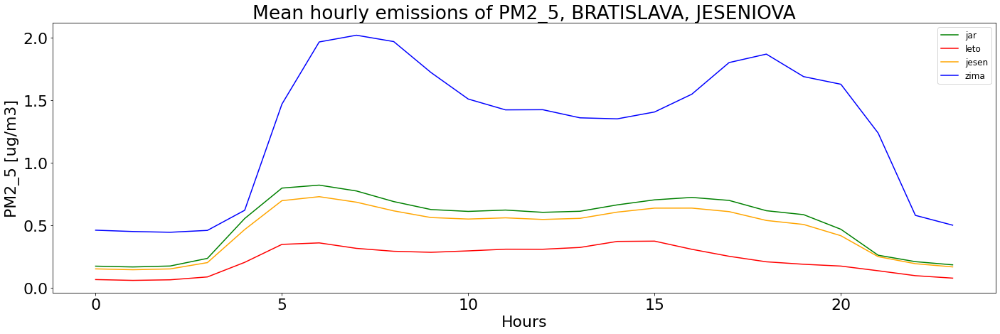

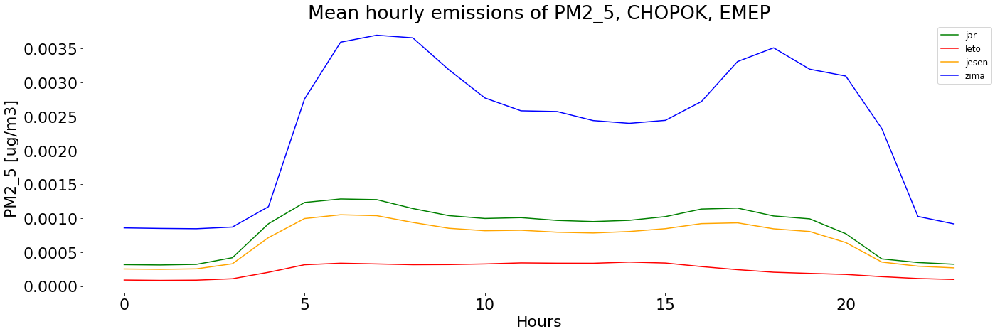

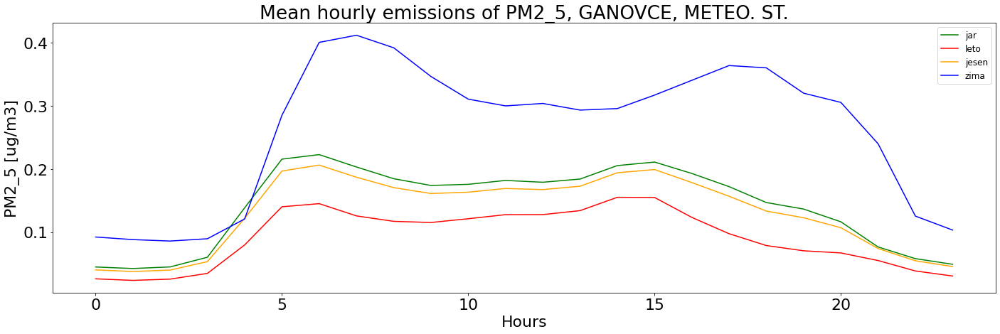

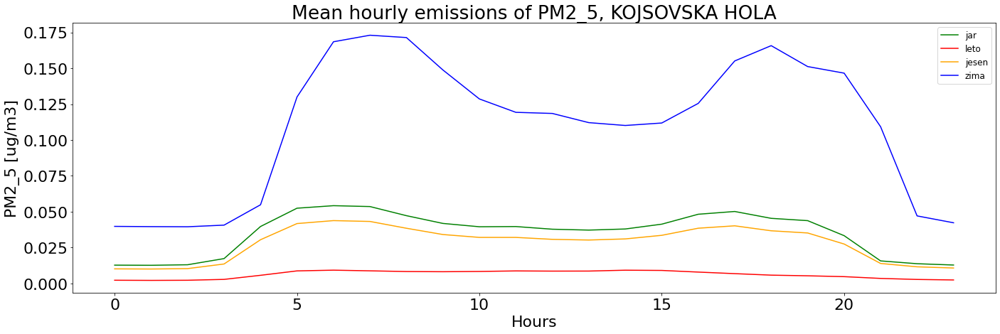

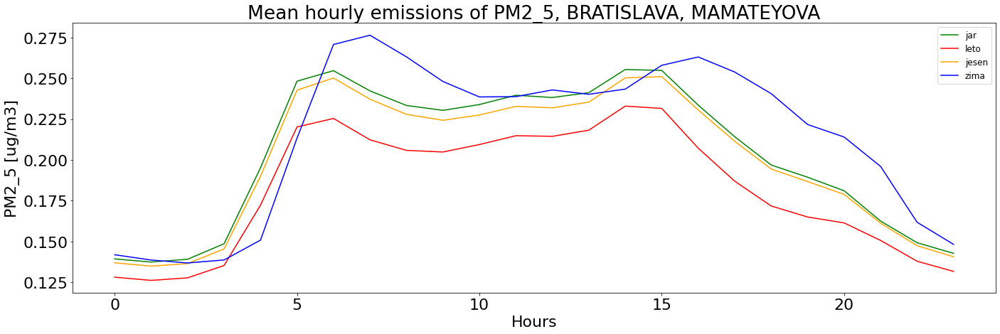

...

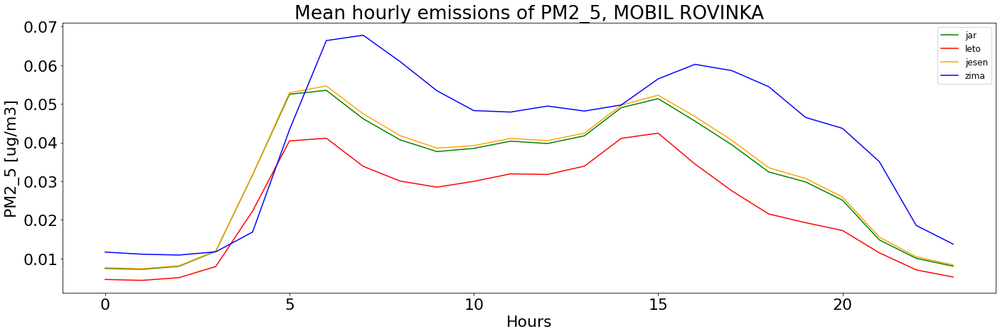

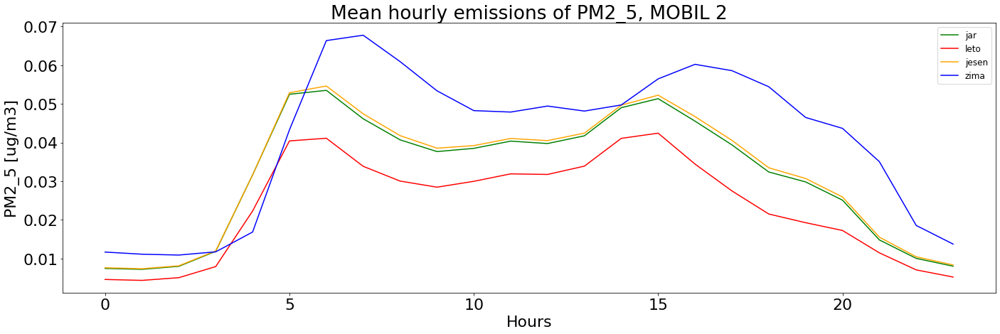

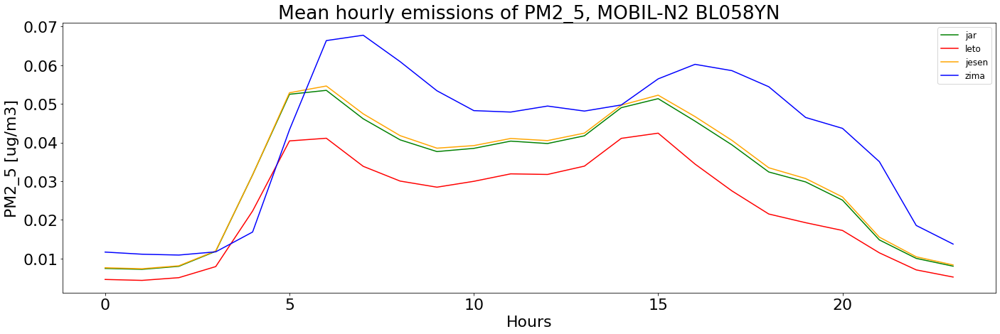

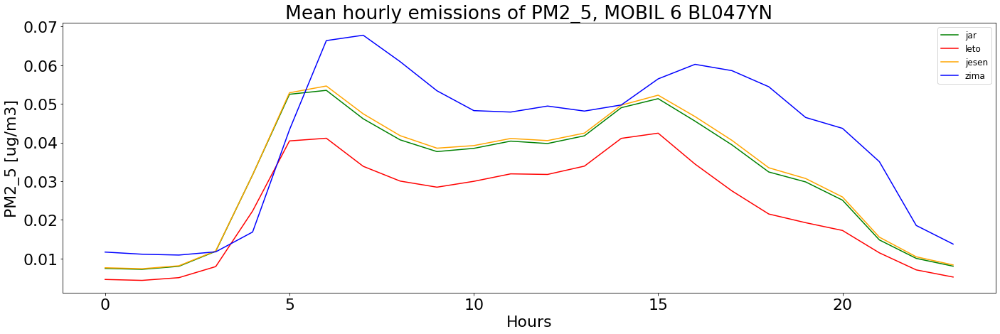

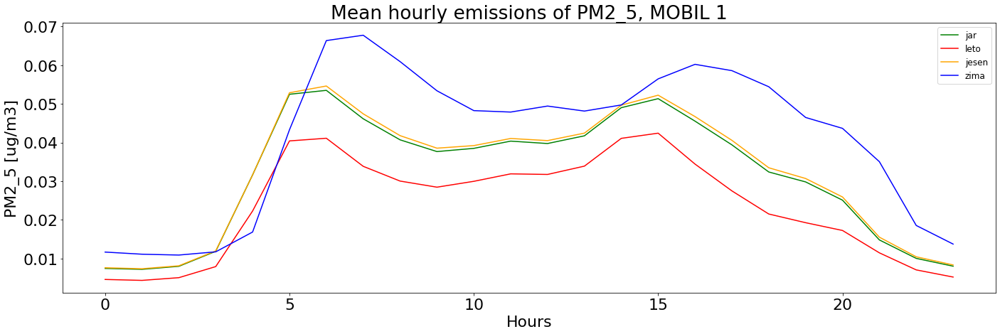

In [11]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    emis_id_jar = emisie_pm25[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_pm25[spec_nick].TSTEP.dt.month.isin(season_months['jar'])).groupby('TSTEP.hour').mean()
    emis_id_leto = emisie_pm25[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_pm25[spec_nick].TSTEP.dt.month.isin(season_months['leto'])).groupby('TSTEP.hour').mean()
    emis_id_jesen = emisie_pm25[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_pm25[spec_nick].TSTEP.dt.month.isin(season_months['jesen'])).groupby('TSTEP.hour').mean()
    emis_id_zima = emisie_pm25[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_pm25[spec_nick].TSTEP.dt.month.isin(season_months['zima'])).groupby('TSTEP.hour').mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(emis_id_jar.hour, emis_id_jar[:,0,0], color ='green', label = 'jar') 
    plt.plot(emis_id_leto.hour, emis_id_leto[:,0,0], color ='red', label = 'leto')
    plt.plot(emis_id_jesen.hour, emis_id_jesen[:,0,0], color ='orange', label = 'jesen') 
    plt.plot(emis_id_zima.hour, emis_id_zima[:,0,0], color ='blue', label = 'zima')

    plt.legend(fontsize=12)                
    plt.title('Mean hourly emissions of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

## Emisie rocne obdobia staton types

Plots will be saved at:/data/teri/validacia/validated/const_emis_2017/graphs/NO2


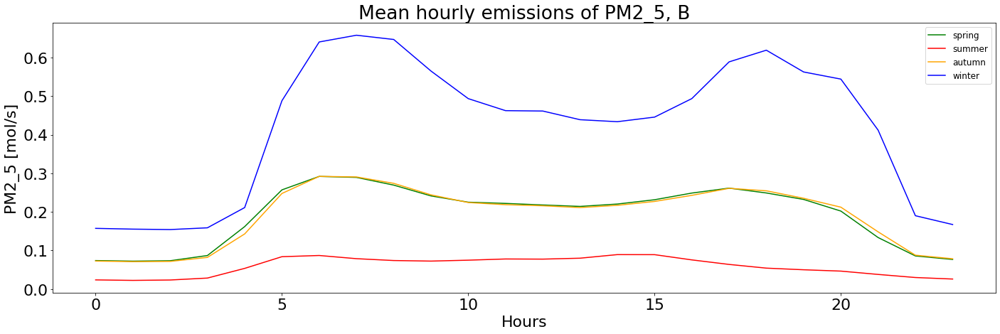

In [51]:
save = True
if save:
    print('Plots will be saved at:{}'.format(save_path))
    
emis_id_leto = emisie_pm25[spec_nick].sel(ROW = 10, COL = 10, TSTEP = emisie_pm25[spec_nick].TSTEP.dt.month.isin(season_months['leto'])).groupby('TSTEP.hour').mean()

#emis_leto_mean = emis_stanice_pm25[spec_nick][ID_B].loc[emis_stanice_pm25[spec_nick]['season']=='leto'].groupby(emis_stanice_pm25[spec_nick][ID_B].loc[emis_stanice_pm25[spec_nick]['season']=='leto'].index.hour).mean().stack()        
#emis_zima_mean = emis_stanice_pm25[spec_nick][ID_B].loc[emis_stanice_pm25[spec_nick]['season']=='zima'].groupby(emis_stanice_pm25[spec_nick][ID_B].loc[emis_stanice_pm25[spec_nick]['season']=='zima'].index.hour).mean().stack()        

emis_jar_mean = emis_stanice_pm25[spec_nick][ID_B].loc[season =='jar'].groupby(emis_stanice_pm25[spec_nick][ID_B].loc[emis_stanice_pm25[spec_nick]['season']=='jar'].index.hour).mean()
emis_jar_mean['daily_avrg'] = emis_jar_mean.mean(axis = 1)

emis_leto_mean = emis_stanice_pm25[spec_nick][ID_B].loc[season =='leto'].groupby(emis_stanice_pm25[spec_nick][ID_B].loc[emis_stanice_pm25[spec_nick]['season']=='leto'].index.hour).mean()
emis_leto_mean['daily_avrg'] = emis_leto_mean.mean(axis = 1)

emis_jesen_mean = emis_stanice_pm25[spec_nick][ID_B].loc[season =='jesen'].groupby(emis_stanice_pm25[spec_nick][ID_B].loc[emis_stanice_pm25[spec_nick]['season']=='jesen'].index.hour).mean()
emis_jesen_mean['daily_avrg'] = emis_jesen_mean.mean(axis = 1)

emis_zima_mean = emis_stanice_pm25[spec_nick][ID_B].loc[season =='zima'].groupby(emis_stanice_pm25[spec_nick][ID_B].loc[emis_stanice_pm25[spec_nick]['season']=='zima'].index.hour).mean()
emis_zima_mean['daily_avrg'] = emis_zima_mean.mean(axis = 1)

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(emis_id_leto.hour, emis_jar_mean['daily_avrg'], color ='green', label = 'spring') 
plt.plot(emis_id_leto.hour, emis_leto_mean['daily_avrg'], color ='red', label = 'summer')
plt.plot(emis_id_leto.hour, emis_jesen_mean['daily_avrg'], color ='orange', label = 'autumn') 
plt.plot(emis_id_leto.hour, emis_zima_mean['daily_avrg'], color ='blue', label = 'winter')

plt.legend(fontsize=12)                
plt.title('Mean hourly emissions of {0}, B'.format(v))                               
plt.xlabel('Hours')
plt.ylabel('{0} [mol/s]'.format(v))
plt.tight_layout()

if save:
    #if not os.path.exists(save_path):
     #   os.makedirs(save_path)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_full_vs_const/grafy/PM2_5/MH_emissions_B_seasons_PM25.png'.format(save_path), dpi=300)                
plt.show()                
plt.close() 

## Hodinovy chod emisii 

In [12]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

spec_nick = 'ref'

plot_from = '2017-01-06'
plot_until = '2017-01-12'  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

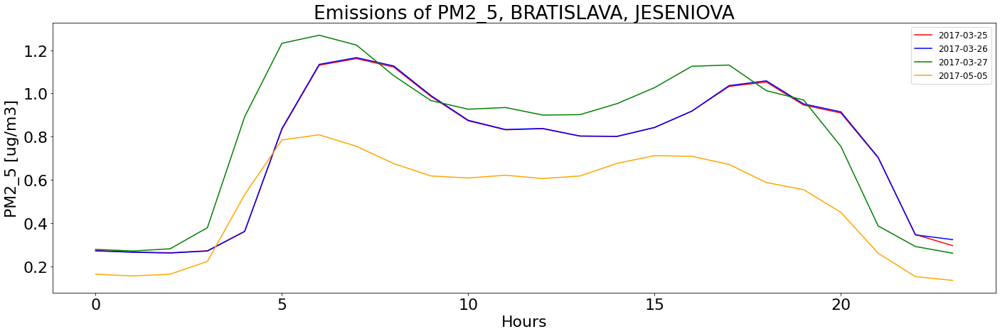

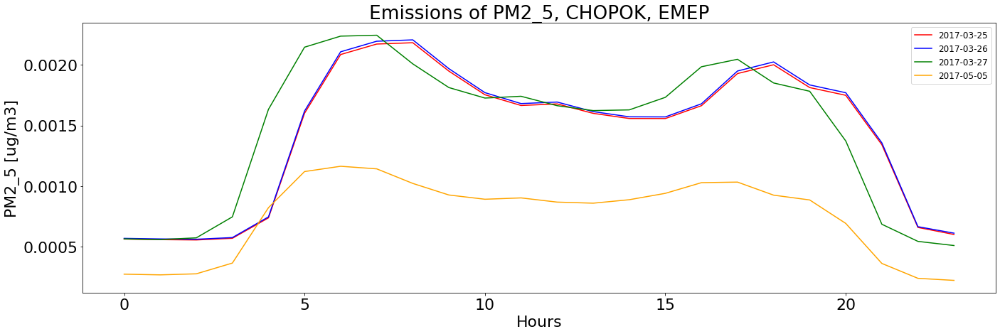

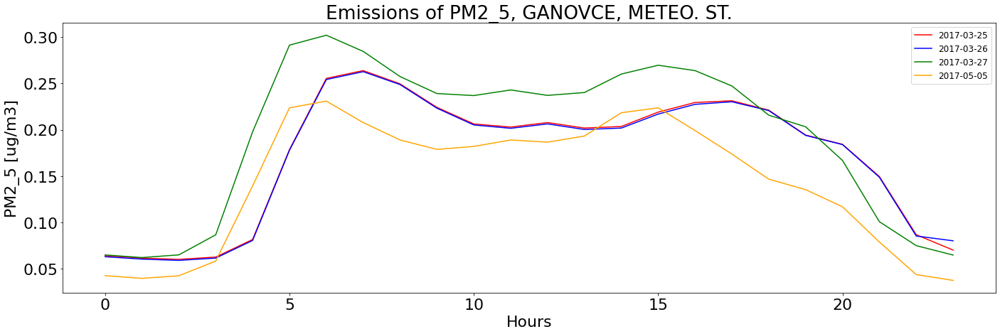

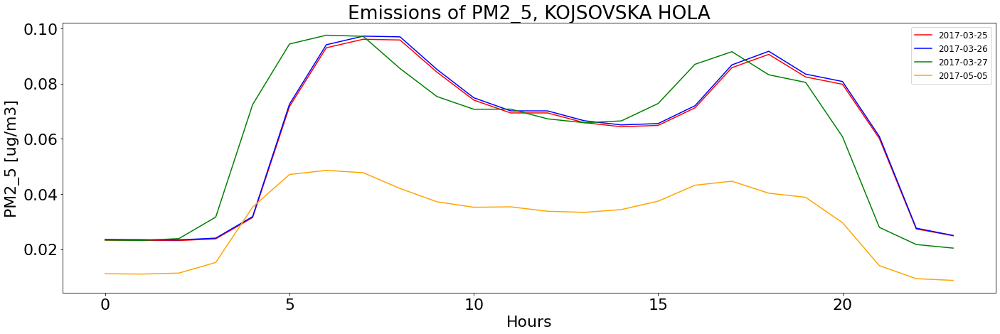

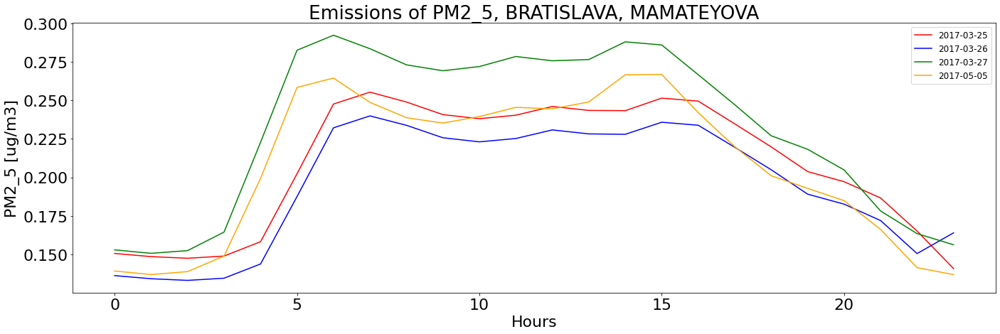

...

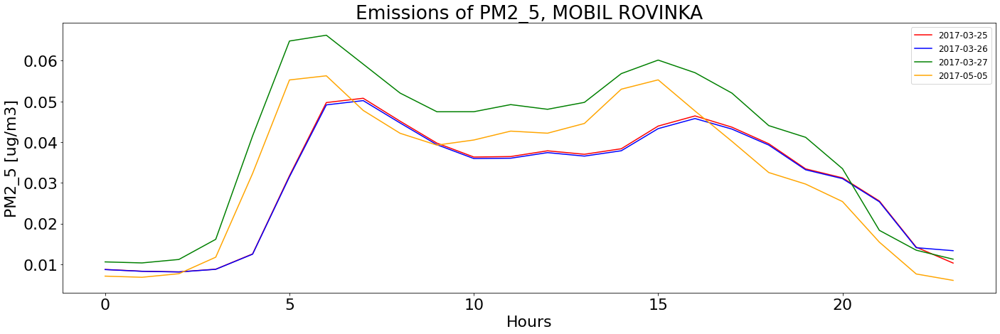

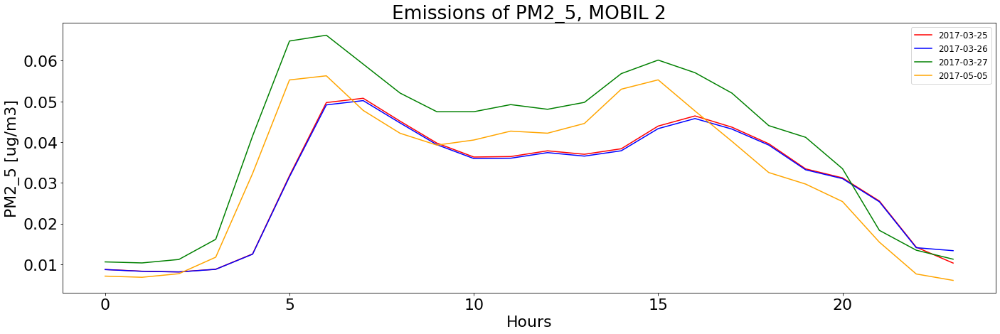

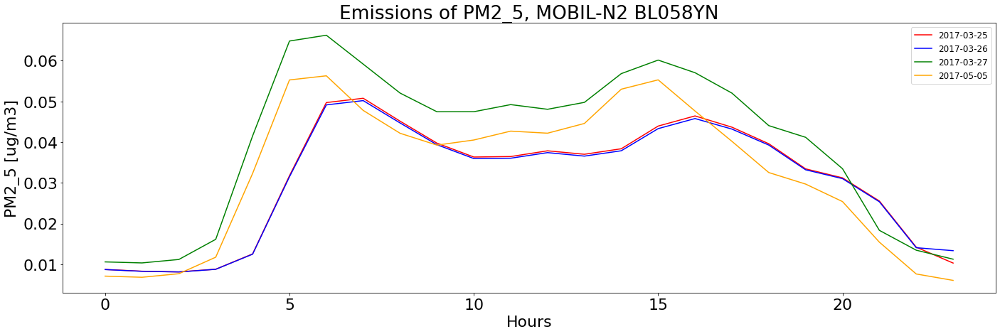

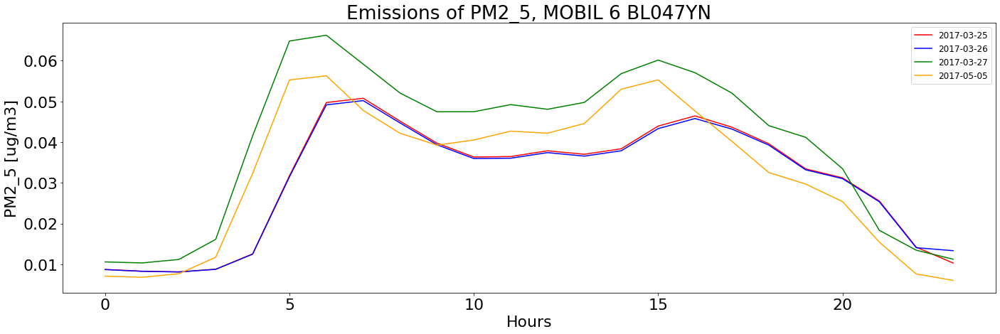

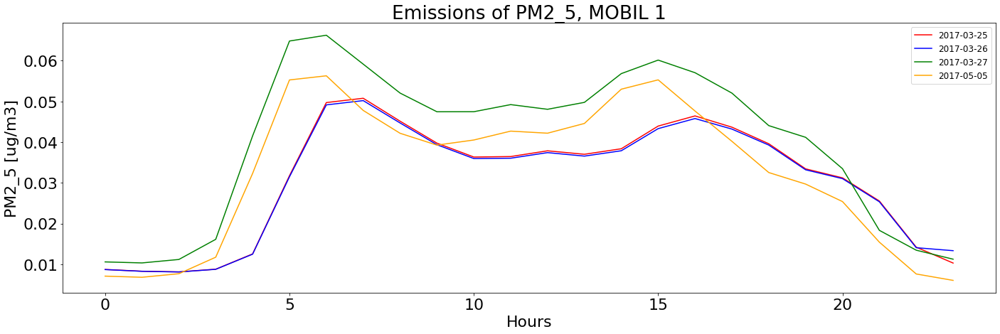

In [13]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    x, y = stanice['x'].loc[stanice.ii == i], stanice['y'].loc[stanice.ii == i]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    emis_id = emisie_pm25[spec_nick].sel(ROW = x, COL = y).to_series()['2017-03-25 00:00:00':'2017-03-25 23:00:00']
    emis_id2 = emisie_pm25[spec_nick].sel(ROW = x, COL = y).to_series()['2017-03-26 00:00:00':'2017-03-26 23:00:00']
    emis_id3 = emisie_pm25[spec_nick].sel(ROW = x, COL = y).to_series()['2017-03-27 00:00:00':'2017-03-27 23:00:00']
    emis_id4 = emisie_pm25[spec_nick].sel(ROW = x, COL = y).to_series()['2017-05-05 00:00:00':'2017-05-05 23:00:00']
    emis_id_mean = emisie_pm25[spec_nick].sel(ROW = x, COL = y, TSTEP = emisie_pm25[spec_nick].TSTEP.dt.month.isin(season_months['mar'])).groupby('TSTEP.hour').mean()
       
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(emis_id_mean.hour, emis_id[:], color ='red', label = '2017-03-25')  
    plt.plot(emis_id_mean.hour, emis_id2[:], color ='blue', label = '2017-03-26')
    plt.plot(emis_id_mean.hour, emis_id3[:], color ='green', label = '2017-03-27')
    plt.plot(emis_id_mean.hour, emis_id4[:], color ='orange', label = '2017-05-05')
    

    plt.legend(fontsize=12)                
    plt.title('Emissions of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Rozdiely koncentracii na mape

cop
2160


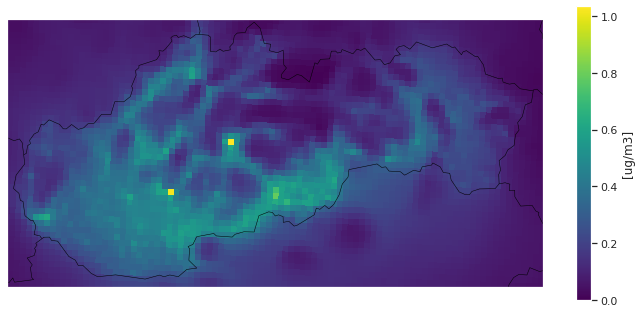

rh_const
2160


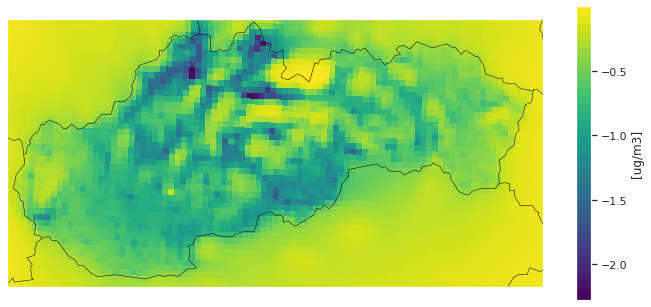

In [172]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'zima'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017'}

#day = 18
ref = xr.open_dataset(ref_path)
cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()

v2 = 'PM25'
#for s in specific:
for i, key in enumerate(specific[0:2]):
    print(key)
    other = xr.open_dataset(other_path[key])
    cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel[v2]))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    #diff = 100*(other_day[v][day,0,:,:] - ref_day[v][day,0,:,:])/ref_day[v][day,0,:,:]
    diff = (other_sel[v2][:,0,:,:] - ref_sel[v2][:,0,:,:]).mean(axis = 0)
    diff_norm = (100*(other_sel[v2][:,0,:,:] - ref_sel[v2][:,0,:,:])/(ref_sel[v2][:,0,:,:])).mean(axis = 0)
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'black')
    cmap = plt.get_cmap('viridis') 
    #im = mapb.pcolormesh(lon, lat, diff, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, diff, cmap=cmap,latlon=True)
    
    cb=plt.colorbar(label='[ug/m3]')
    #cb=plt.colorbar(label='[%]')
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/diff_{0}_map_SR_{1}_{2}.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


In [149]:
other


<xarray.Dataset>
Dimensions:  (COL: 184, DATE-TIME: 2, LAY: 1, ROW: 103, TSTEP: 8760, VAR: 3)
Coordinates:
  * TSTEP    (TSTEP) datetime64[ns] 2017-01-01 ... 2017-12-31T23:00:00
Dimensions without coordinates: COL, DATE-TIME, LAY, ROW, VAR
Data variables:
    TFLAG    (TSTEP, VAR, DATE-TIME) int32 2017001 0 2017001 ... 2017365 230000
    AORGBJ   (TSTEP, LAY, ROW, COL) float32 ...
    PM25     (TSTEP, LAY, ROW, COL) float32 ...
    PM10     (TSTEP, LAY, ROW, COL) float32 ...
Attributes:
    IOAPI_VERSION:  
    EXEC_ID:        ????????????????                                         ...
    FTYPE:          1
    CDATE:          2021273
    CTIME:          84605
    WDATE:          2021273
    WTIME:          84605
    SDATE:          2017001
    STIME:          0
    TSTEP:          10000
    NTHIK:          1
    NCOLS:          184
    NROWS:          103
    NLAYS:          1
    NVARS:          3
    GDTYP:          2
    P_ALP:          46.245
    P_BET:          46.245
    P_GAM:          17.0
    XCENT:          17.0
    YCENT:          46.245
    XORIG:          -426051.625
    YORIG:          110832.765625
    XCELL:          4710.62109375
    YCELL:          4710.62109375
    VGTYP:          7
    VGTOP:          2000.0
    VGLVLS:         [1. 0.]
    GDNAM:          Small           
    UPNAM:          COMBINE         
    VAR-LIST:       AORGBJ          PM25            PM10            
    FILEDESC:       Concentration file output                                ...
    HISTORY:

## Korelacia koncentracii na mape

cop
2160


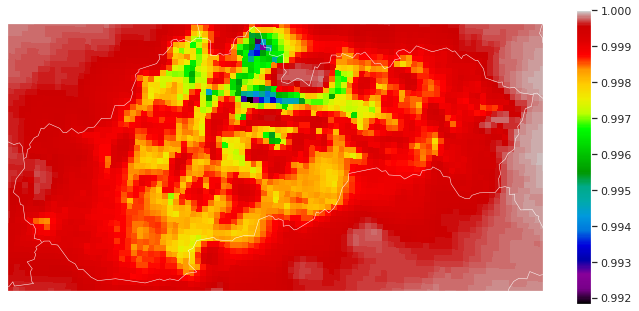

rh_const
2160


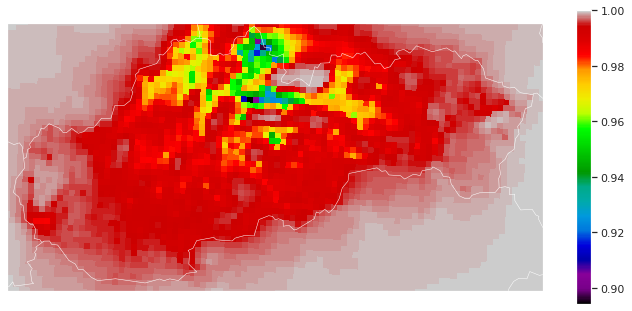

In [178]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'zima'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017'}

#day = 18
ref = xr.open_dataset(ref_path)
cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()
v2 = 'PM25'

#for s in specific:
for i, key in enumerate(specific[0:2]):
    print(key)
    other = xr.open_dataset(other_path[key])
    cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel[v2]))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    corr=xr.corr(ref_sel[v2][:,0,:,:], other_sel[v2][:,0,:,:], dim='TSTEP')
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'white')
    cmap = plt.get_cmap('nipy_spectral') 
    #im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True)
    
    cb=plt.colorbar()
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/correlation_{0}_map_SR_{1}_{2}.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


In [75]:
my_season = 'rok'
#other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))

other_sel

<xarray.DataArray 'PM10' (TSTEP: 8760, LAY: 1, ROW: 103, COL: 184)>
[166019520 values with dtype=float32]
Coordinates:
  * TSTEP    (TSTEP) datetime64[ns] 2017-01-01 ... 2017-12-31T23:00:00
Dimensions without coordinates: LAY, ROW, COL
Attributes:
    long_name:  PM10            
    units:      ug/m3           
    var_desc:   ASOIL[1] + ACORS[1] + PM25[0]                                ...

## Korelacia emisii na mape

cop
2160


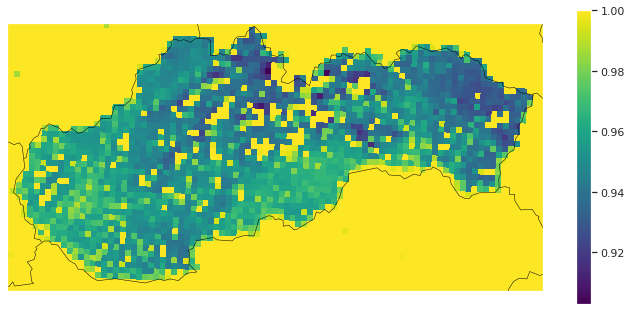

rh_const
2160


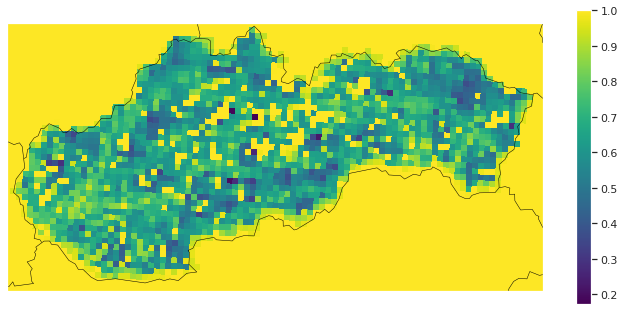

In [183]:
from mpl_toolkits.basemap import Basemap
import netCDF4
#from matplotlib import colors
plt.rcParams['figure.figsize'] = 12,5.4
#from matplotlib.colors import from_levels_and_colors
#from matplotlib.colors import BoundaryNorm
#import seaborn as sns
#sns.set()
my_season = 'zima'

grid=netCDF4.Dataset('/data/oko/teri/cmaq_data/GRIDCRO2D_2017-01-01_d02.nc')
lon=np.array(grid.variables['LON'][0,0,:,:])     
lat=np.array(grid.variables['LAT'][0,0,:,:])

levely=[0.88,0.9,0.92,0.94,0.96,0.98,1]

#pal_num={'GnBu':'04'}
other_path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017', 'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017'}

#day = 18
ref = emisie_pm25['ref']
#cmaq_to_datetimes(ref)   
ref_sel = ref.sel(TSTEP = ref.TSTEP.dt.month.isin(season_months[my_season]))
#ref_day = ref.resample({'TSTEP':'D'}).mean()


#for s in specific:
for i, key in enumerate(emisie_list[1:3]):
    print(key)
    other = emisie_pm25[key]
    #cmaq_to_datetimes(other)
    other_sel = other.sel(TSTEP = other.TSTEP.dt.month.isin(season_months[my_season]))
    print(len(other_sel))
    #other_day = other.resample({'TSTEP':'D'}).mean()
               
    corr=xr.corr(ref_sel[:,:,:], other_sel[:,:,:], dim='TSTEP')
    #diff = 100*(other_day[v][day,0,:,:] - ref_day[v][day,0,:,:])/ref_day[v][day,0,:,:]
    
    mapb=Basemap(projection='lcc',lat_1=46.24470138549805,lat_2=46.24470138549805,lat_0=48.66,lon_0=19.7,width=432780,height=216351,resolution='i') #SLOVENSKO
    mapb.drawcountries(color = 'black')
    cmap = plt.get_cmap('viridis') 
    #im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True, vmin = levely[0], vmax = levely[-1])
    im = mapb.pcolormesh(lon, lat, corr, cmap=cmap,latlon=True)
    
    cb=plt.colorbar()
    #cb.set_ticks(levely)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/{0}/corr_emisie_{0}_map_SR_{1}_{2}.png'.format(v,my_season,key), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()


# O3

In [58]:
v = 'O3'
ref_path = '/data/oko/dusan/POST/WB_2020_{0}_2017'.format(v)
other_path = ['/data/oko/dusan/POST/WB_const_{0}_2017'.format(v),
       '/data/oko/dusan/POST/WB_totcons_{0}_2017'.format(v)]

for i in range(0, len(specific)):
    print(specific[i])
    stat[specific[i]], data[specific[i]] = vali.comparison(ref_path, other_path[i], ref_model_name, other_model_name[i], ref_grid_name, other_grid_name[i], start_date, end_date, v)
    

tot_const
Comparison of O3 done in 3.3245182037353516 seconds
rh_const
Comparison of O3 done in 3.4299111366271973 seconds


In [53]:
#data['rh_const'].sel(time = data['rh_const'].time.dt.month.isin([3,4,5]))
#model ma coverage vsade, takze ked chcem vybrat len stanice ktore pouzivam aj pri obs, tak treba zobrat zoznam kde sa vylucia
#stanice s nulovym pokrytim (z validacneho scriptu)
ID_B = [11813,11916,11952,11958,99111,99134,99215,99224,99246,99252,99281,99351,99401,99403,99404]
len(ID_B)

15

## Statistika (R, RMSE, BIAS, MGE) s referencnym runom

In [54]:
stat_all = stat[specific[0]][['name','loc','type']].copy()
stat_all.head()

for s in statistiky:
    for i in specific:
        stat_all['{0}_{1}'.format(s,i)] = stat[i][s]

#stat_all.head()
stat_all

,name,loc,type,bias_tot_const,bias_rh_const,mge_tot_const,mge_rh_const,rmse_tot_const,rmse_rh_const,r_tot_const,r_rh_const
all,all,all,all,-0.225992,-0.720034,0.382099,1.45733,0.696029,2.38184,0.999261,0.989728
11813,"BRATISLAVA, JESENIOVA",S,B,-0.537509,-1.88525,0.596327,3.02907,0.887142,4.67297,0.999509,0.977314
11916,"CHOPOK, EMEP",R,B,0.0632454,-0.0228515,0.200764,0.503504,0.379982,0.747764,0.99941,0.997443
11952,"GANOVCE, METEO. ST.",R,B,-0.313912,-1.03389,0.503423,1.84247,0.757357,2.69324,0.998683,0.979978
11958,KOJSOVSKA HOLA,R,B,-0.070135,-0.175551,0.30461,0.788132,0.556063,1.0825,0.999123,0.996193
99111,"BRATISLAVA, MAMATEYOVA",U,B,-0.483861,-1.81411,0.537855,2.80215,0.856397,4.31885,0.99954,0.981824
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,-0.537509,-1.88525,0.596327,3.02907,0.887142,4.67297,0.999509,0.977314
99114,"BRATISLAVA, KAMENNE NAM.",U,B,-0.537509,-1.88525,0.596327,3.02907,0.887142,4.67297,0.999509,0.977314
99117,BRATISLAVA - RACA,None,None,-0.308562,-1.05181,0.381742,1.95116,0.616044,2.96196,0.999612,0.987506
99122,"SENICA, HVIEZDOSLAVOVA",U,T,-0.0960732,-0.424482,0.233169,1.20097,0.475153,1.64717,0.999614,0.994901


In [56]:
emisie_full

<xarray.Dataset>
Dimensions:  (COL: 184, DATE-TIME: 2, LAY: 7, ROW: 103, TSTEP: 25, VAR: 29)
Dimensions without coordinates: COL, DATE-TIME, LAY, ROW, TSTEP, VAR
Data variables:
    TFLAG    (TSTEP, VAR, DATE-TIME) int32 ...
    NH3      (TSTEP, LAY, ROW, COL) float32 ...
    ALDX     (TSTEP, LAY, ROW, COL) float32 ...
    ISOP     (TSTEP, LAY, ROW, COL) float32 ...
    NO2      (TSTEP, LAY, ROW, COL) float32 ...
    POC      (TSTEP, LAY, ROW, COL) float32 ...
    BAP      (TSTEP, LAY, ROW, COL) float32 ...
    XYL      (TSTEP, LAY, ROW, COL) float32 ...
    FORM     (TSTEP, LAY, ROW, COL) float32 ...
    PSO4     (TSTEP, LAY, ROW, COL) float32 ...
    NR       (TSTEP, LAY, ROW, COL) float32 ...
    BENZENE  (TSTEP, LAY, ROW, COL) float32 ...
    PEC      (TSTEP, LAY, ROW, COL) float32 ...
    ETHA     (TSTEP, LAY, ROW, COL) float32 ...
    TERP     (TSTEP, LAY, ROW, COL) float32 ...
    ETH      (TSTEP, LAY, ROW, COL) float32 ...
    SO2      (TSTEP, LAY, ROW, COL) float32 ...
    NO       (TSTEP, LAY, ROW, COL) float32 ...
    CO       (TSTEP, LAY, ROW, COL) float32 ...
    PMC      (TSTEP, LAY, ROW, COL) float32 ...
    ETOH     (TSTEP, LAY, ROW, COL) float32 ...
    PAR      (TSTEP, LAY, ROW, COL) float32 ...
    IOLE     (TSTEP, LAY, ROW, COL) float32 ...
    CH4      (TSTEP, LAY, ROW, COL) float32 ...
    PMFINE   (TSTEP, LAY, ROW, COL) float32 ...
    PNO3     (TSTEP, LAY, ROW, COL) float32 ...
    ALD2     (TSTEP, LAY, ROW, COL) float32 ...
    TOL      (TSTEP, LAY, ROW, COL) float32 ...
    MEOH     (TSTEP, LAY, ROW, COL) float32 ...
    OLE      (TSTEP, LAY, ROW, COL) float32 ...
Attributes:
    EXEC_ID:   ????????????????
    FTYPE:     1
    SDATE:     2017001
    STIME:     0
    CDATE:     2018101
    CTIME:     3147
    WDATE:     2018101
    WTIME:     3147
    TSTEP:     10000
    NTHIK:     1
    NCOLS:     184
    NROWS:     103
    NLAYS:     7
    NVARS:     29
    GDTYP:     2
    VGTYP:     7
    VGTOP:     2000.0
    VGLVLS:    [1.    0.993 0.983 0.97  0.954 0.934 0.909 0.88 ]
    P_ALP:     46.24470064
    P_BET:     46.24470064
    P_GAM:     17.0
    XCENT:     17.0
    YCENT:     46.24470064
    XORIG:     -426051.625
    YORIG:     110832.765625
    XCELL:     4710.62109375
    YCELL:     4710.62109375
    GDNAM:     CMAQ_d02_grid
    UPNAM:     ???
    HISTORY:   ???
    VAR-LIST:  NH3             ALDX            ISOP            NO2           ...
    FILEDESC:  emisieF

## Priprava emisii NO

In [59]:
v = 'NO'
emisie_list = ['ref','tot_const','rh_const']
emisie_file = {'ref':'WB_2017_d02', 'rh_const':'WB_2017_const', 'tot_const':'WB_2017_totcons'}
emisie_no = {}

for e in emisie_list:
    print(e)
    start_time = time.time()
    emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],start_date[:10]))
    emisie_no[e] = emisie_full[v][:(-1),:,:,:].sum(axis=1)
    
    for i in range(n_start+1,n_days + 1):
        date = doy.date_from_day(i, start_date[0:4])
        emisie_full = xr.open_dataset('/data/oko/dusan/emisie_2017/{0}-{1}.nc'.format(emisie_file[e],date))
        emisie_new = emisie_full[v][:(-1),:,:,:].sum(axis=1)
        emisie_no[e] = xr.concat([emisie_no[e], emisie_new], 'TSTEP')

    print('{0}-{1} done in {2} s'.format(start_date,date,time.time()-start_time))

ref
2017-01-01 00:00:00-2017-12-31 done in 153.3709614276886 s
tot_const
2017-01-01 00:00:00-2017-12-31 done in 158.70839262008667 s
rh_const
2017-01-01 00:00:00-2017-12-31 done in 152.22396326065063 s


In [60]:
times=pd.date_range(start=start_date, end=end_date, freq='H')
for e in emisie_list:
    emisie_no[e].coords['TSTEP']=times
    emisie_no[e].coords['ROW'] = np.linspace(0,102,103)
    emisie_no[e].coords['COL'] = np.linspace(0,183,184)
    
emisie_no

{'ref': <xarray.DataArray 'NO' (TSTEP: 8760, ROW: 103, COL: 184)>
 array([[[3.9543649e-03, 4.5949821e-03, 1.0527258e-03, ...,
          1.6484663e-03, 1.7096566e-03, 2.0128463e-03],
         [3.8558780e-03, 4.7766301e-03, 1.4082355e-03, ...,
          1.9277357e-03, 1.7395781e-03, 1.4892804e-03],
         [5.1356587e-03, 5.9477049e-03, 2.0818112e-03, ...,
          4.8440793e-03, 5.4424894e-03, 6.1113308e-03],
         ...,
         [1.5755531e+00, 9.1098920e-03, 8.8291252e-03, ...,
          4.5465631e-03, 4.2221867e-03, 2.8434342e-03],
         [3.2659110e-03, 2.7696302e-03, 2.2758411e-03, ...,
          3.2673466e-03, 3.2571598e-03, 2.6984271e-03],
         [1.4490023e-03, 1.2387214e-03, 1.2356003e-03, ...,
          2.1133283e-03, 2.2820674e-03, 2.3865115e-03]],
 
        [[3.2298276e-03, 3.7139342e-03, 8.7314739e-04, ...,
          1.5723824e-03, 1.6334158e-03, 1.9285635e-03],
         [3.1525725e-03, 3.8357510e-03, 1.1475566e-03, ...,
          1.8403742e-03, 1.6631178e-03, 1.433

In [61]:
emis_stanice_no = {}

for e in emisie_list:
    emis_stanice_no[e] = pd.DataFrame()
    emis_stanice_no[e]['season'] = pd.Series(season)
    for i in ID:
        x = stanice['x'].loc[stanice.ii == i].item()
        y = stanice['y'].loc[stanice.ii == i].item()
        emis_stanice_no[e][i] = pd.Series(emisie_no[e][:,x,y])

    new_index = pd.date_range(start_date, end_date , freq='H')
    emis_stanice_no[e] = emis_stanice_no[e].set_index(new_index)
    
#new_mean = emis_stanice_no['ref'][ID_B].loc[season =='leto'].groupby(emis_stanice_no['ref'][ID_B].loc[emis_stanice_no['ref']['season']=='leto'].index.hour).mean()

#new_mean['daily_avrg'] = new_mean.mean(axis = 1)
#new_mean['daily_avrg']

## Emisie rocne obdobia staton types

Plots will be saved at:/data/teri/validacia/validated/const_emis_2017/graphs/NO2


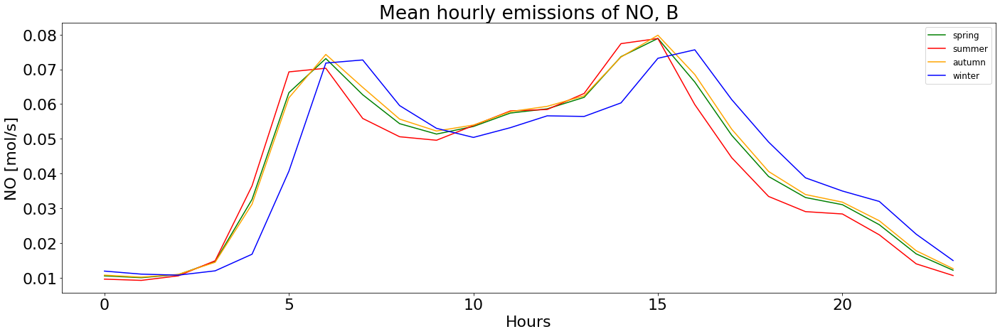

In [63]:
save = True
if save:
    print('Plots will be saved at:{}'.format(save_path))
    
emis_id_leto = emisie_no[spec_nick].sel(ROW = 10, COL = 10, TSTEP = emisie_no[spec_nick].TSTEP.dt.month.isin(season_months['leto'])).groupby('TSTEP.hour').mean()

#emis_leto_mean = emis_stanice_no[spec_nick][ID_B].loc[emis_stanice_no[spec_nick]['season']=='leto'].groupby(emis_stanice_no[spec_nick][ID_B].loc[emis_stanice_no[spec_nick]['season']=='leto'].index.hour).mean().stack()        
#emis_zima_mean = emis_stanice_no[spec_nick][ID_B].loc[emis_stanice_no[spec_nick]['season']=='zima'].groupby(emis_stanice_no[spec_nick][ID_B].loc[emis_stanice_no[spec_nick]['season']=='zima'].index.hour).mean().stack()        

emis_jar_mean = emis_stanice_no[spec_nick][ID_B].loc[season =='jar'].groupby(emis_stanice_no[spec_nick][ID_B].loc[emis_stanice_no[spec_nick]['season']=='jar'].index.hour).mean()
emis_jar_mean['daily_avrg'] = emis_jar_mean.mean(axis = 1)

emis_leto_mean = emis_stanice_no[spec_nick][ID_B].loc[season =='leto'].groupby(emis_stanice_no[spec_nick][ID_B].loc[emis_stanice_no[spec_nick]['season']=='leto'].index.hour).mean()
emis_leto_mean['daily_avrg'] = emis_leto_mean.mean(axis = 1)

emis_jesen_mean = emis_stanice_no[spec_nick][ID_B].loc[season =='jesen'].groupby(emis_stanice_no[spec_nick][ID_B].loc[emis_stanice_no[spec_nick]['season']=='jesen'].index.hour).mean()
emis_jesen_mean['daily_avrg'] = emis_jesen_mean.mean(axis = 1)

emis_zima_mean = emis_stanice_no[spec_nick][ID_B].loc[season =='zima'].groupby(emis_stanice_no[spec_nick][ID_B].loc[emis_stanice_no[spec_nick]['season']=='zima'].index.hour).mean()
emis_zima_mean['daily_avrg'] = emis_zima_mean.mean(axis = 1)

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(emis_id_leto.hour, emis_jar_mean['daily_avrg'], color ='green', label = 'spring') 
plt.plot(emis_id_leto.hour, emis_leto_mean['daily_avrg'], color ='red', label = 'summer')
plt.plot(emis_id_leto.hour, emis_jesen_mean['daily_avrg'], color ='orange', label = 'autumn') 
plt.plot(emis_id_leto.hour, emis_zima_mean['daily_avrg'], color ='blue', label = 'winter')

plt.legend(fontsize=12)                
plt.title('Mean hourly emissions of {0}, B'.format(v))                               
plt.xlabel('Hours')
plt.ylabel('{0} [mol/s]'.format(v))
plt.tight_layout()

if save:
    #if not os.path.exists(save_path):
     #   os.makedirs(save_path)
    plt.savefig('/data/teri/validacia/validated/CMAQ2017d02_full_vs_const/grafy/O3/MH_emissions_B_seasons_NO.png'.format(save_path), dpi=300)                
plt.show()                
plt.close() 